In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Feature distribution before preprocessing

https://colab.research.google.com/drive/1syfaxP-50j0G5aIubAr2eALokKJYVFsY

# Methods for handling missing values

https://colab.research.google.com/drive/1Y46uNmaYzcDoNCmC-Y9V5C2udnn9zfLh

### Load Data

In [178]:
df_same_yb = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/merged_data_yb_same.csv')
df_int_yb = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/merged_data_yb_interpolation.csv')

In [179]:
df_same_yb['Date'] = pd.to_datetime(df_same_yb['Date'])
df_int_yb['Date'] = pd.to_datetime(df_int_yb['Date'])

In [180]:
df_same_sw = pd.read_excel('/content/drive/MyDrive/Time Series Project/Stock Price/data/sw_samevalue.xlsx')
df_int_sw = pd.read_excel('/content/drive/MyDrive/Time Series Project/Stock Price/data/sw_interpolation.xlsx')

In [181]:
df_same_mk = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/삼전-일별동일값(원).csv')
df_int_mk = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/삼전-일별보간(원).csv')

In [182]:
df_same_mk['Date'] = pd.to_datetime(df_same_mk['Date'])
df_int_mk['Date'] = pd.to_datetime(df_int_mk['Date'])

In [183]:
df_same_rd = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/merged_raudhah_copied.csv')
df_int_rd = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/merged_raudhah_interpolate.csv')

In [184]:
df_same_rd['Date'] = pd.to_datetime(df_same_rd['Date'])
df_int_rd['Date'] = pd.to_datetime(df_int_rd['Date'])

In [185]:
df_samsung = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/samsung stock.csv')
df_samsung.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction
0,2000-08-02,6100,6170,5930,6070,743825,NaN,4515017750
1,2000-08-03,6180,6180,5970,6030,556342,-0.006590,3354742260
2,2000-08-04,5930,6010,5850,5920,472137,-0.018242,2795051040
3,2000-08-07,5740,5770,5580,5580,575355,-0.057432,3210480900
4,2000-08-08,5660,5750,5570,5580,669550,0.000000,3736089000


In [186]:
df_samsung['Date'] = pd.to_datetime(df_samsung['Date'])

### Merge Dataset - same

In [187]:
df_same1 = pd.merge(df_same_yb, df_same_sw, on = 'Date', how = 'left')
df_same1.head()

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung,...,SOX_Close,SOX_Open,SOX_High,SOX_Low,SOX_Change Volume,US Economic Growth Rate,KR Economic Growth Rate,US GDP Annual,KR GDP Annual,CN GDP Annual
0,2001-01-01,6.5,5.12,5.25,7.21,NaN,1264.5,1,1,7.1,...,NaN,NaN,NaN,NaN,NaN,-1.3,1.2,2.2,4.5,9.5
1,2001-01-02,6.5,4.92,5.25,7.18,27.21,1276.4,1,1,7.1,...,570.3,576.6,595.6,558.7,-0.0109,-1.3,1.2,2.2,4.5,9.5
2,2001-01-03,6.0,5.14,5.25,7.15,28.00,1270.1,1,1,7.1,...,670.2,570.3,670.5,556.5,0.1752,-1.3,1.2,2.2,4.5,9.5
3,2001-01-04,6.0,5.03,5.25,6.85,28.14,1255.0,1,1,7.1,...,653.8,670.2,684.8,643.4,-0.0245,-1.3,1.2,2.2,4.5,9.5
4,2001-01-05,6.0,4.93,5.25,6.68,27.95,1263.5,1,1,7.1,...,617.5,653.8,660.3,612.0,-0.0555,-1.3,1.2,2.2,4.5,9.5


In [188]:
df_same2 = pd.merge(df_same1, df_same_mk, on = 'Date', how = 'left')
df_same2

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung,...,US Economic Growth Rate,KR Economic Growth Rate,US GDP Annual,KR GDP Annual,CN GDP Annual,Operating_Profit,Net_Profit,Total_Equity,Total_Liabilities,Revenue
0,2001-01-01,6.5,5.12,5.25,7.210,NaN,1264.5,1,1,7.1,...,-1.3,1.2,2.2,4.5,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13
1,2001-01-02,6.5,4.92,5.25,7.180,27.21,1276.4,1,1,7.1,...,-1.3,1.2,2.2,4.5,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13
2,2001-01-03,6.0,5.14,5.25,7.150,28.00,1270.1,1,1,7.1,...,-1.3,1.2,2.2,4.5,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13
3,2001-01-04,6.0,5.03,5.25,6.850,28.14,1255.0,1,1,7.1,...,-1.3,1.2,2.2,4.5,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13
4,2001-01-05,6.0,4.93,5.25,6.680,27.95,1263.5,1,1,7.1,...,-1.3,1.2,2.2,4.5,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6191,2024-09-24,5.0,3.74,3.50,3.026,71.56,1334.9,1,2,18.3,...,2.8,0.1,2.7,1.5,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13
6192,2024-09-25,5.0,3.79,3.50,2.997,69.69,1331.0,1,2,18.3,...,2.8,0.1,2.7,1.5,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13
6193,2024-09-26,5.0,3.79,3.50,3.001,67.67,1327.2,1,2,18.3,...,2.8,0.1,2.7,1.5,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13
6194,2024-09-27,5.0,3.75,3.50,3.000,68.18,1318.6,1,2,18.3,...,2.8,0.1,2.7,1.5,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13


In [189]:
df_same3 = pd.merge(df_same2, df_same_rd, on = 'Date', how = 'left')
df_same3

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung,...,CN GDP Annual,Operating_Profit,Net_Profit,Total_Equity,Total_Liabilities,Revenue,inflation_USA,inflation_kor,inflation_china,unemployment_kor
0,2001-01-01,6.5,5.12,5.25,7.210,NaN,1264.5,1,1,7.1,...,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13,2.88,3.44,0.72,4.4
1,2001-01-02,6.5,4.92,5.25,7.180,27.21,1276.4,1,1,7.1,...,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13,2.88,3.44,0.72,4.4
2,2001-01-03,6.0,5.14,5.25,7.150,28.00,1270.1,1,1,7.1,...,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13,2.88,3.44,0.72,4.4
3,2001-01-04,6.0,5.03,5.25,6.850,28.14,1255.0,1,1,7.1,...,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13,2.88,3.44,0.72,4.4
4,2001-01-05,6.0,4.93,5.25,6.680,27.95,1263.5,1,1,7.1,...,9.5,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13,2.88,3.44,0.72,4.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6191,2024-09-24,5.0,3.74,3.50,3.026,71.56,1334.9,1,2,18.3,...,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13,NaN,1.61,0.10,2.5
6192,2024-09-25,5.0,3.79,3.50,2.997,69.69,1331.0,1,2,18.3,...,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13,NaN,1.61,0.10,2.5
6193,2024-09-26,5.0,3.79,3.50,3.001,67.67,1327.2,1,2,18.3,...,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13,NaN,1.61,0.10,2.5
6194,2024-09-27,5.0,3.75,3.50,3.000,68.18,1318.6,1,2,18.3,...,4.6,9.183370e+12,1.010090e+13,3.862810e+14,1.050260e+14,7.909870e+13,NaN,1.61,0.10,2.5


In [190]:
df_same4 = pd.merge(df_same3, df_samsung, on = 'Date', how = 'right')
df_same4

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung,...,inflation_kor,inflation_china,unemployment_kor,Open,High,Low,Close,Volume,Change,Transaction
0,2000-08-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,6100,6170,5930,6070,743825,NaN,4515017750
1,2000-08-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,6180,6180,5970,6030,556342,-0.006590,3354742260
2,2000-08-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5930,6010,5850,5920,472137,-0.018242,2795051040
3,2000-08-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5740,5770,5580,5580,575355,-0.057432,3210480900
4,2000-08-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5660,5750,5570,5580,669550,0.000000,3736089000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5995,2024-11-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,57000,57500,55900,56700,48095234,0.059813,2726999767800
5996,2024-11-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,56500,57500,55900,56300,31539632,-0.007055,1775681281600
5997,2024-11-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,56100,56500,54800,55300,20864667,-0.017762,1153816085100
5998,2024-11-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,54900,56900,54700,56400,19096850,0.019892,1077062340000


In [191]:
df_same4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6000 entries, 0 to 5999
Data columns (total 39 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   Date                          6000 non-null   datetime64[ns]
 1   us_base                       5865 non-null   float64       
 2   us_10                         5865 non-null   float64       
 3   kor_base                      5865 non-null   float64       
 4   kor_10                        5865 non-null   float64       
 5   WTI                           5673 non-null   float64       
 6   exchange                      5865 non-null   float64       
 7   US_president                  5865 non-null   float64       
 8   KOR_president                 5865 non-null   float64       
 9   Samsung                       5865 non-null   float64       
 10  Covid-19                      5865 non-null   object        
 11  Foreign Holdings              

In [192]:
df_same4 = df_same4.rename(columns = {'Samsung' : 'Phone', 'Operating_Profit' : 'SE_Operating_Profit', 'Net_Profit' : 'SE_Net_Profit',
       'Total_Equity' : 'SE_Total_Equity', 'Total_Liabilities' : 'SE_Total_Liabilities', 'Revenue' : 'SE_Revenue',
       'us_base' : 'US_Base', 'us_10' : 'US_10', 'kor_base' : 'KR_Base', 'kor_10' : 'KR_10',
       'KOR_president' : 'KR_President', 'US_president' : 'US_President',
       'inflation_USA' : 'US_Inflation', 'inflation_kor' : 'KR_Inflation', 'inflation_china' : 'CN_Inflation',
       'unemployment_kor' : 'KR_Unemployment',
       'exchange' : 'Exchange',
       'Foreign Holdings' : 'Foreign_Holdings', 'Foreign Ownership Percentage' : 'Foreign_Ownership_Percentage',
       'US Economic Growth Rate' : 'US_Economic_Growth_Rate', 'KR Economic Growth Rate' : 'KR_Economic_Growth_Rate', 'US GDP Annual' : 'US_GDP_Annual',
       'KR GDP Annual' : 'KR_GDP_Annual', 'CN GDP Annual' : 'CN_GDP_Annual', 'SOX_Change Volume':'SOX_Change_Volume'
                                      })

In [193]:
df_same4.columns

Index(['Date', 'US_Base', 'US_10', 'KR_Base', 'KR_10', 'WTI', 'Exchange',
       'US_President', 'KR_President', 'Phone', 'Covid-19', 'Foreign_Holdings',
       'Foreign_Ownership_Percentage', 'SOX_Close', 'SOX_Open', 'SOX_High',
       'SOX_Low', 'SOX_Change_Volume', 'US_Economic_Growth_Rate',
       'KR_Economic_Growth_Rate', 'US_GDP_Annual', 'KR_GDP_Annual',
       'CN_GDP_Annual', 'SE_Operating_Profit', 'SE_Net_Profit',
       'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'US_Inflation',
       'KR_Inflation', 'CN_Inflation', 'KR_Unemployment', 'Open', 'High',
       'Low', 'Close', 'Volume', 'Change', 'Transaction'],
      dtype='object')

In [194]:
df_same4 = df_same4.rename(columns = {'Foreign_Ownership_Percentage':'SE_Foreign'})

In [195]:
df_same4 = df_same4.rename(columns = {'Covid-19':'Covid19'})

In [196]:
df_same4.columns

Index(['Date', 'US_Base', 'US_10', 'KR_Base', 'KR_10', 'WTI', 'Exchange',
       'US_President', 'KR_President', 'Phone', 'Covid19', 'Foreign_Holdings',
       'SE_Foreign', 'SOX_Close', 'SOX_Open', 'SOX_High', 'SOX_Low',
       'SOX_Change_Volume', 'US_Economic_Growth_Rate',
       'KR_Economic_Growth_Rate', 'US_GDP_Annual', 'KR_GDP_Annual',
       'CN_GDP_Annual', 'SE_Operating_Profit', 'SE_Net_Profit',
       'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'US_Inflation',
       'KR_Inflation', 'CN_Inflation', 'KR_Unemployment', 'Open', 'High',
       'Low', 'Close', 'Volume', 'Change', 'Transaction'],
      dtype='object')

In [197]:
len(df_same4.columns)

39

In [198]:
df_same = df_same4[['Date', 'Open', 'High','Low', 'Close', 'Volume', 'Change', 'Transaction',
                    'SE_Operating_Profit', 'SE_Net_Profit', 'SE_Total_Equity', 'SE_Total_Liabilities','SE_Revenue', 'SE_Foreign',
                    'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual', 'KR_GDP_Annual', 'CN_GDP_Annual',
                    'US_Economic_Growth_Rate', 'KR_Economic_Growth_Rate',
                    'US_Base', 'US_10', 'KR_Base', 'KR_10','WTI', 'Exchange','SOX_Close','Phone', 'KR_Unemployment',
                    'US_President', 'KR_President', 'Covid19'
                    ]]

In [199]:
len(df_same.columns)

34

In [200]:
df_same = df_same[99:5964]

In [201]:
df_same.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
99,2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.060340e+12,6.002880e+12,...,5.25,7.18,27.21,1276.4,570.3,7.1,4.4,1.0,1.0,False
100,2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,...,5.25,7.15,28.00,1270.1,670.2,7.1,4.4,1.0,1.0,False
101,2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.060340e+12,6.002880e+12,...,5.25,6.85,28.14,1255.0,653.8,7.1,4.4,1.0,1.0,False
102,2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,...,5.25,6.68,27.95,1263.5,617.5,7.1,4.4,1.0,1.0,False
103,2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,...,5.25,6.60,27.32,1265.8,634.2,7.1,4.4,1.0,1.0,False


In [202]:
to_remove = ['2018-04-30', '2018-05-02', '2018-05-03']
df_same = df_same[~df_same['Date'].isin(to_remove)]
df_same.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 34 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5799 non-null   float64       
 12  SE_Revenue               5862 non-null

<ipython-input-202-37bcdaa538ae>:2: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  df_same = df_same[~df_same['Date'].isin(to_remove)]


In [120]:
!pip install ta

In [121]:
import ta

In [203]:
bb = ta.volatility.BollingerBands(df_same['Close'], window=20)
df_same['BB_High'] = bb.bollinger_hband()  # 상단 밴드
df_same['BB_Low'] = bb.bollinger_lband()   # 하단 밴드

# RSI (Relative Strength Index)
rsi = ta.momentum.RSIIndicator(df_same['Close'], window=14)
df_same['RSI'] = rsi.rsi()

# Volume_Price_Ratio
df_same['Volume_Price_Ratio'] = df_same['Volume'] / df_same['Close']

# Volume_Momentum
df_same['Volume_Momentum'] = df_same['Volume'].diff()

# High_Low_Volatility
df_same['High_Low_Volatility'] = (df_same['High'] - df_same['Low']) / df_same['Close']

# Lagged Features (1일, 30일, 60일, 90일)
lag_days = [1, 30, 60, 90]
for lag in lag_days:
    df_same[f'Lag_{lag}'] = df_same['Close'].shift(lag)

In [204]:
df_same.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/final_same.csv')

### Merge dataset - Interpolation

In [205]:
df_int1 = pd.merge(df_int_yb, df_int_sw, on = 'Date', how = 'left')
df_int1

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung_spline,...,SOX_Close,SOX_Open,SOX_High,SOX_Low,SOX_Change Volume,US Economic Growth Rate,KR Economic Growth Rate,US GDP Annual,KR GDP Annual,CN GDP Annual
0,2001-01-01,6.5,5.12,5.25,7.210,NaN,1264.5,1,1,7.100000,...,NaN,NaN,NaN,NaN,NaN,-1.300000,1.200000,2.200000,4.5,9.50
1,2001-01-02,6.5,4.92,5.25,7.180,27.21,1276.4,1,1,7.114173,...,570.3,576.6,595.6,558.7,-0.0109,-1.257778,1.204444,2.186667,4.5,9.49
2,2001-01-03,6.0,5.14,5.25,7.150,28.00,1270.1,1,1,7.128294,...,670.2,570.3,670.5,556.5,0.1752,-1.215556,1.208889,2.173333,4.5,9.48
3,2001-01-04,6.0,5.03,5.25,6.850,28.14,1255.0,1,1,7.142364,...,653.8,670.2,684.8,643.4,-0.0245,-1.173333,1.213333,2.160000,4.5,9.47
4,2001-01-05,6.0,4.93,5.25,6.680,27.95,1263.5,1,1,7.156383,...,617.5,653.8,660.3,612.0,-0.0555,-1.131111,1.217778,2.146667,4.5,9.46
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6191,2024-09-24,5.0,3.74,3.50,3.026,71.56,1334.9,1,2,32.695149,...,5091.8,5071.5,5119.8,5009.7,0.0131,2.800000,0.100000,2.700000,1.5,4.60
6192,2024-09-25,5.0,3.79,3.50,2.997,69.69,1331.0,1,2,33.002998,...,5132.5,5078.3,5167.8,5078.3,0.0080,2.800000,0.100000,2.700000,1.5,4.60
6193,2024-09-26,5.0,3.79,3.50,3.001,67.67,1327.2,1,2,33.314668,...,5310.5,5352.3,5356.0,5182.5,0.0347,2.800000,0.100000,2.700000,1.5,4.60
6194,2024-09-27,5.0,3.75,3.50,3.000,68.18,1318.6,1,2,33.630180,...,5217.2,5318.0,5318.1,5190.7,-0.0176,2.800000,0.100000,2.700000,1.5,4.60


In [206]:
df_int2 = pd.merge(df_int1, df_int_mk, on = 'Date', how = 'left')
df_int2

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung_spline,...,US Economic Growth Rate,KR Economic Growth Rate,US GDP Annual,KR GDP Annual,CN GDP Annual,Operating_Profit,Net_Profit,Total_Equity,Total_Liabilities,Revenue
0,2001-01-01,6.5,5.12,5.25,7.210,NaN,1264.5,1,1,7.100000,...,-1.300000,1.200000,2.200000,4.5,9.50,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13
1,2001-01-02,6.5,4.92,5.25,7.180,27.21,1276.4,1,1,7.114173,...,-1.257778,1.204444,2.186667,4.5,9.49,9.070090e+12,6.002880e+12,1.678550e+13,2.963194e+13,4.352208e+13
2,2001-01-03,6.0,5.14,5.25,7.150,28.00,1270.1,1,1,7.128294,...,-1.215556,1.208889,2.173333,4.5,9.48,9.079520e+12,6.002880e+12,1.678550e+13,2.962800e+13,4.351655e+13
3,2001-01-04,6.0,5.03,5.25,6.850,28.14,1255.0,1,1,7.142364,...,-1.173333,1.213333,2.160000,4.5,9.47,9.088620e+12,6.002880e+12,1.678550e+13,2.962421e+13,4.351120e+13
4,2001-01-05,6.0,4.93,5.25,6.680,27.95,1263.5,1,1,7.156383,...,-1.131111,1.217778,2.146667,4.5,9.46,9.097401e+12,6.002880e+12,1.678550e+13,2.962055e+13,4.350605e+13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6191,2024-09-24,5.0,3.74,3.50,3.026,71.56,1334.9,1,2,32.695149,...,2.800000,0.100000,2.700000,1.5,4.60,3.279430e+14,1.010090e+13,3.862814e+14,1.137930e+14,9.048790e+13
6192,2024-09-25,5.0,3.79,3.50,2.997,69.69,1331.0,1,2,33.002998,...,2.800000,0.100000,2.700000,1.5,4.60,3.393928e+14,1.010090e+13,3.862814e+14,1.139566e+14,9.061750e+13
6193,2024-09-26,5.0,3.79,3.50,3.001,67.67,1327.2,1,2,33.314668,...,2.800000,0.100000,2.700000,1.5,4.60,3.511122e+14,1.010090e+13,3.862814e+14,1.141218e+14,9.074620e+13
6194,2024-09-27,5.0,3.75,3.50,3.000,68.18,1318.6,1,2,33.630180,...,2.800000,0.100000,2.700000,1.5,4.60,3.631042e+14,1.010090e+13,3.862814e+14,1.142888e+14,9.087400e+13


In [207]:
df_int2.columns

Index(['Date', 'us_base', 'us_10', 'kor_base', 'kor_10', 'WTI', 'exchange',
       'US_president', 'KOR_president', 'Samsung_spline', 'Covid-19',
       'Foreign Holdings', 'Foreign Ownership Percentage', 'SOX_Close',
       'SOX_Open', 'SOX_High', 'SOX_Low', 'SOX_Change Volume',
       'US Economic Growth Rate', 'KR Economic Growth Rate', 'US GDP Annual',
       'KR GDP Annual', 'CN GDP Annual', 'Operating_Profit', 'Net_Profit',
       'Total_Equity', 'Total_Liabilities', 'Revenue'],
      dtype='object')

In [208]:
#df_int2.drop(columns = ['Unnamed: 6'], inplace = True)

In [209]:
df_int3 = pd.merge(df_int2, df_int_rd, on = 'Date', how = 'inner')
df_int3

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung_spline,...,CN GDP Annual,Operating_Profit,Net_Profit,Total_Equity,Total_Liabilities,Revenue,inflation_USA,inflation_kor,inflation_china,unemployment_kor
0,2001-01-01,6.5,5.12,5.25,7.210,NaN,1264.5,1,1,7.100000,...,9.50,9.060340e+12,6.002880e+12,1.678550e+13,2.963600e+13,4.352780e+13,2.880000,3.440000,0.720000,4.400000
1,2001-01-02,6.5,4.92,5.25,7.180,27.21,1276.4,1,1,7.114173,...,9.49,9.070090e+12,6.002880e+12,1.678550e+13,2.963194e+13,4.352208e+13,2.883226,3.446129,0.720000,4.409677
2,2001-01-03,6.0,5.14,5.25,7.150,28.00,1270.1,1,1,7.128294,...,9.48,9.079520e+12,6.002880e+12,1.678550e+13,2.962800e+13,4.351655e+13,2.886452,3.452258,0.720000,4.419355
3,2001-01-04,6.0,5.03,5.25,6.850,28.14,1255.0,1,1,7.142364,...,9.47,9.088620e+12,6.002880e+12,1.678550e+13,2.962421e+13,4.351120e+13,2.889677,3.458387,0.720000,4.429032
4,2001-01-05,6.0,4.93,5.25,6.680,27.95,1263.5,1,1,7.156383,...,9.46,9.097401e+12,6.002880e+12,1.678550e+13,2.962055e+13,4.350605e+13,2.892903,3.464516,0.720000,4.438710
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6191,2024-09-24,5.0,3.74,3.50,3.026,71.56,1334.9,1,2,32.695149,...,4.60,3.279430e+14,1.010090e+13,3.862814e+14,1.137930e+14,9.048790e+13,4.100000,1.295667,0.176667,2.653333
6192,2024-09-25,5.0,3.79,3.50,2.997,69.69,1331.0,1,2,33.002998,...,4.60,3.393928e+14,1.010090e+13,3.862814e+14,1.139566e+14,9.061750e+13,4.100000,1.282000,0.180000,2.660000
6193,2024-09-26,5.0,3.79,3.50,3.001,67.67,1327.2,1,2,33.314668,...,4.60,3.511122e+14,1.010090e+13,3.862814e+14,1.141218e+14,9.074620e+13,4.100000,1.268333,0.183333,2.666667
6194,2024-09-27,5.0,3.75,3.50,3.000,68.18,1318.6,1,2,33.630180,...,4.60,3.631042e+14,1.010090e+13,3.862814e+14,1.142888e+14,9.087400e+13,4.100000,1.254667,0.186667,2.673333


In [210]:
df_int4 = pd.merge(df_int3, df_samsung, on = 'Date', how = 'right')
df_int4

,Date,us_base,us_10,kor_base,kor_10,WTI,exchange,US_president,KOR_president,Samsung_spline,...,inflation_kor,inflation_china,unemployment_kor,Open,High,Low,Close,Volume,Change,Transaction
0,2000-08-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,6100,6170,5930,6070,743825,NaN,4515017750
1,2000-08-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,6180,6180,5970,6030,556342,-0.006590,3354742260
2,2000-08-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5930,6010,5850,5920,472137,-0.018242,2795051040
3,2000-08-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5740,5770,5580,5580,575355,-0.057432,3210480900
4,2000-08-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5660,5750,5570,5580,669550,0.000000,3736089000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5995,2024-11-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,57000,57500,55900,56700,48095234,0.059813,2726999767800
5996,2024-11-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,56500,57500,55900,56300,31539632,-0.007055,1775681281600
5997,2024-11-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,56100,56500,54800,55300,20864667,-0.017762,1153816085100
5998,2024-11-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,54900,56900,54700,56400,19096850,0.019892,1077062340000


In [211]:
df_int4 = df_int4.rename(columns = {'Samsung' : 'Phone', 'Operating_Profit' : 'SE_Operating_Profit', 'Net_Profit' : 'SE_Net_Profit',
       'Total_Equity' : 'SE_Total_Equity', 'Total_Liabilities' : 'SE_Total_Liabilities', 'Revenue' : 'SE_Revenue',
       'us_base' : 'US_Base', 'us_10' : 'US_10', 'kor_base' : 'KR_Base', 'kor_10' : 'KR_10',
       'KOR_president' : 'KR_President', 'US_president' : 'US_President',
       'inflation_USA' : 'US_Inflation', 'inflation_kor' : 'KR_Inflation', 'inflation_china' : 'CN_Inflation',
       'unemployment_kor' : 'KR_Unemployment',
       'exchange' : 'Exchange',
       'Foreign Holdings' : 'Foreign_Holdings', 'Foreign Ownership Percentage' : 'Foreign_Ownership_Percentage',
       'US Economic Growth Rate' : 'US_Economic_Growth_Rate', 'KR Economic Growth Rate' : 'KR_Economic_Growth_Rate', 'US GDP Annual' : 'US_GDP_Annual',
       'KR GDP Annual' : 'KR_GDP_Annual', 'CN GDP Annual' : 'CN_GDP_Annual', 'SOX_Change Volume':'SOX_Change_Volume'
                                      })
df_int4 = df_int4.rename(columns = {'Foreign_Ownership_Percentage':'SE_Foreign'})

In [212]:
df_int4 = df_int4.rename(columns = {'Samsung_spline':'Phone'})

In [213]:
df_int4 = df_int4.rename(columns = {'Covid-19':'Covid19'})

In [214]:
df_int4.columns

Index(['Date', 'US_Base', 'US_10', 'KR_Base', 'KR_10', 'WTI', 'Exchange',
       'US_President', 'KR_President', 'Phone', 'Covid19', 'Foreign_Holdings',
       'SE_Foreign', 'SOX_Close', 'SOX_Open', 'SOX_High', 'SOX_Low',
       'SOX_Change_Volume', 'US_Economic_Growth_Rate',
       'KR_Economic_Growth_Rate', 'US_GDP_Annual', 'KR_GDP_Annual',
       'CN_GDP_Annual', 'SE_Operating_Profit', 'SE_Net_Profit',
       'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'US_Inflation',
       'KR_Inflation', 'CN_Inflation', 'KR_Unemployment', 'Open', 'High',
       'Low', 'Close', 'Volume', 'Change', 'Transaction'],
      dtype='object')

In [215]:
df_int = df_int4[['Date', 'Open', 'High','Low', 'Close', 'Volume', 'Change', 'Transaction',
                    'SE_Operating_Profit', 'SE_Net_Profit', 'SE_Total_Equity', 'SE_Total_Liabilities','SE_Revenue', 'SE_Foreign',
                    'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual', 'KR_GDP_Annual', 'CN_GDP_Annual',
                    'US_Economic_Growth_Rate', 'KR_Economic_Growth_Rate',
                    'US_Base', 'US_10', 'KR_Base', 'KR_10','WTI', 'Exchange','SOX_Close','Phone', 'KR_Unemployment',
                    'US_President', 'KR_President', 'Covid19'
                    ]]

In [216]:
len(df_int.columns)

34

In [217]:
df_int.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
0,2000-08-02,6100,6170,5930,6070,743825,NaN,4515017750,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2000-08-03,6180,6180,5970,6030,556342,-0.006590,3354742260,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2000-08-04,5930,6010,5850,5920,472137,-0.018242,2795051040,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2000-08-07,5740,5770,5580,5580,575355,-0.057432,3210480900,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2000-08-08,5660,5750,5570,5580,669550,0.000000,3736089000,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [218]:
df_int = df_int[99:5964]

In [219]:
to_remove = ['2018-04-30', '2018-05-02', '2018-05-03']
df_int = df_int[~df_int['Date'].isin(to_remove)]
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 34 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

<ipython-input-219-5ca9b2f9812f>:2: FutureWarning: The behavior of 'isin' with dtype=datetime64[ns] and castable values (e.g. strings) is deprecated. In a future version, these will not be considered matching by isin. Explicitly cast to the appropriate dtype before calling isin instead.
  df_int = df_int[~df_int['Date'].isin(to_remove)]


In [220]:
bb = ta.volatility.BollingerBands(df_int['Close'], window=20)
df_int['BB_High'] = bb.bollinger_hband()  # 상단 밴드
df_int['BB_Low'] = bb.bollinger_lband()   # 하단 밴드

# RSI (Relative Strength Index)
rsi = ta.momentum.RSIIndicator(df_int['Close'], window=14)
df_int['RSI'] = rsi.rsi()

# Volume_Price_Ratio
df_int['Volume_Price_Ratio'] = df_int['Volume'] / df_int['Close']

# Volume_Momentum
df_int['Volume_Momentum'] = df_int['Volume'].diff()

# High_Low_Volatility
df_int['High_Low_Volatility'] = (df_int['High'] - df_int['Low']) / df_int['Close']

# Lagged Features (1일, 30일, 60일, 90일)
lag_days = [1, 30, 60, 90]
for lag in lag_days:
    df_int[f'Lag_{lag}'] = df_int['Close'].shift(lag)

In [221]:
df_int.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/final_int.csv')

### Final Process Nan - Same

In [222]:
df_same.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5799 non-null   float64       
 12  SE_Revenue               5862 non-null

In [223]:
df_same.fillna(method='ffill', inplace=True)

<ipython-input-223-17a6e9d57d56>:1: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_same.fillna(method='ffill', inplace=True)
<ipython-input-223-17a6e9d57d56>:1: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_same.fillna(method='ffill', inplace=True)


In [224]:
df_same.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [225]:
df_same.fillna(method='bfill', inplace=True)

<ipython-input-225-046fbd26fb7b>:1: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_same.fillna(method='bfill', inplace=True)


In [226]:
df_same.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [227]:
df_same.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Change',
       'Transaction', 'SE_Operating_Profit', 'SE_Net_Profit',
       'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'SE_Foreign',
       'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual',
       'KR_GDP_Annual', 'CN_GDP_Annual', 'US_Economic_Growth_Rate',
       'KR_Economic_Growth_Rate', 'US_Base', 'US_10', 'KR_Base', 'KR_10',
       'WTI', 'Exchange', 'SOX_Close', 'Phone', 'KR_Unemployment',
       'US_President', 'KR_President', 'Covid19', 'BB_High', 'BB_Low', 'RSI',
       'Volume_Price_Ratio', 'Volume_Momentum', 'High_Low_Volatility', 'Lag_1',
       'Lag_30', 'Lag_60', 'Lag_90'],
      dtype='object')

In [228]:
df_same['US_President'] = df_same['US_President'].astype('category')
df_same['KR_President'] = df_same['KR_President'].astype('category')
df_same.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [229]:
df_same.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/final_final_same.csv')

### Final Process of Nan - Interpolation

In [230]:
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [231]:
df_int['WTI'] = df_int['WTI'].interpolate(method='linear')
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [232]:
df_int['SOX_Close'] = df_int['SOX_Close'].interpolate(method='linear')
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [233]:
df_int.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
99,2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.070090e+12,6.002880e+12,...,NaN,NaN,NaN,235.560299,NaN,0.071642,NaN,NaN,NaN,NaN
100,2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.079520e+12,6.002880e+12,...,NaN,NaN,NaN,224.671513,-31984.0,0.059347,3350.0,NaN,NaN,NaN
101,2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.088620e+12,6.002880e+12,...,NaN,NaN,NaN,634.457143,1641105.0,0.055556,3370.0,NaN,NaN,NaN
102,2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.097401e+12,6.002880e+12,...,NaN,NaN,NaN,400.703590,-835504.0,0.056410,3780.0,NaN,NaN,NaN
103,2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.121873e+12,6.002880e+12,...,NaN,NaN,NaN,218.018299,-716833.0,0.033505,3900.0,NaN,NaN,NaN


In [234]:
df_int['BB_High'] = df_int['BB_High'].interpolate(method='linear', limit_direction='both')
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [235]:
df_int['BB_Low'] = df_int['BB_Low'].interpolate(method='linear', limit_direction='both')
df_int['RSI'] = df_int['RSI'].interpolate(method='linear', limit_direction='both')
df_int['Volume_Momentum'] = df_int['Volume_Momentum'].interpolate(method='linear', limit_direction='both')
df_int['Lag_1'] = df_int['Lag_1'].interpolate(method='linear', limit_direction='both')
df_int['Lag_30'] = df_int['Lag_1'].interpolate(method='linear', limit_direction='both')
df_int['Lag_60'] = df_int['Lag_1'].interpolate(method='linear', limit_direction='both')
df_int['Lag_90'] = df_int['Lag_1'].interpolate(method='linear', limit_direction='both')

In [236]:
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [237]:
df_int.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
99,2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.070090e+12,6.002880e+12,...,4674.156324,3317.843676,87.234267,235.560299,-31984.0,0.071642,3350.0,3350.0,3350.0,3350.0
100,2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.079520e+12,6.002880e+12,...,4674.156324,3317.843676,87.234267,224.671513,-31984.0,0.059347,3350.0,3350.0,3350.0,3350.0
101,2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.088620e+12,6.002880e+12,...,4674.156324,3317.843676,87.234267,634.457143,1641105.0,0.055556,3370.0,3370.0,3370.0,3370.0
102,2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.097401e+12,6.002880e+12,...,4674.156324,3317.843676,87.234267,400.703590,-835504.0,0.056410,3780.0,3780.0,3780.0,3780.0
103,2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.121873e+12,6.002880e+12,...,4674.156324,3317.843676,87.234267,218.018299,-716833.0,0.033505,3900.0,3900.0,3900.0,3900.0


In [238]:
df_int['US_President'] = df_int['US_President'].astype('category')
df_int['KR_President'] = df_int['KR_President'].astype('category')
df_int['Covid19'] = df_int['Covid19'].astype(bool)

In [239]:
df_int.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [240]:
df_int.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/final_final_int.csv')

### Plot - Same

In [241]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

In [242]:
same = df_same
same = same.set_index('Date')
same

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,235.560299,-31984.0,0.071642,3350.0,3350.0,3350.0,3350.0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,224.671513,-31984.0,0.059347,3350.0,3350.0,3350.0,3350.0
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,634.457143,1641105.0,0.055556,3370.0,3350.0,3350.0,3350.0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,400.703590,-835504.0,0.056410,3780.0,3350.0,3350.0,3350.0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,218.018299,-716833.0,0.033505,3900.0,3350.0,3350.0,3350.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-24,62800,63400,62400,63200,26957500,0.009585,1703714000000,9.183370e+12,1.010090e+13,3.862810e+14,...,79694.052019,59335.947981,26.061574,426.542722,-1584876.0,0.015823,62600.0,74700.0,81300.0,78400.0
2024-09-25,63800,64200,62200,62200,28652438,-0.015823,1782181643600,9.183370e+12,1.010090e+13,3.862810e+14,...,78665.401755,58814.598245,24.370687,460.650129,1694938.0,0.032154,63200.0,73400.0,81600.0,78300.0
2024-09-26,63900,64900,63700,64700,37566015,0.040193,2430521170500,9.183370e+12,1.010090e+13,3.862810e+14,...,77638.072666,58701.927334,35.616990,580.618470,8913577.0,0.018547,62200.0,74700.0,81500.0,78200.0


In [243]:
df_same.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5862 entries, 99 to 5963
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     5862 non-null   datetime64[ns]
 1   Open                     5862 non-null   int64         
 2   High                     5862 non-null   int64         
 3   Low                      5862 non-null   int64         
 4   Close                    5862 non-null   int64         
 5   Volume                   5862 non-null   int64         
 6   Change                   5862 non-null   float64       
 7   Transaction              5862 non-null   int64         
 8   SE_Operating_Profit      5862 non-null   float64       
 9   SE_Net_Profit            5862 non-null   float64       
 10  SE_Total_Equity          5862 non-null   float64       
 11  SE_Total_Liabilities     5862 non-null   float64       
 12  SE_Revenue               5862 non-null

In [244]:
def feature_dist(data, x_size, y_size, x_label, y_label, grid_flag, path):
    date = data.index
    fig, axes = plt.subplots(nrows=4, ncols=11, figsize=(x_size, y_size))
    axes = axes.flatten()

    for i, feature in enumerate(data.columns):  # 열 이름을 가져옴
        ax = axes[i]
        if i not in [30, 31, 32]:
          ax.plot(date, data[feature])
        else:
          ax.step(date, data[feature], where = 'post')  # 해당 열의 데이터 사용
        ax.xaxis.set_major_locator(mdates.YearLocator())
        ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

        ax.set_title(f'Processing Missing Value - {feature}')  # 제목에 feature 이름 추가
        ax.set_xlabel(x_label)
        ax.set_ylabel(y_label)
        ax.tick_params(axis='x', rotation=45)
        ax.grid(grid_flag)

    plt.tight_layout()
    plt.savefig(path)
    plt.show()

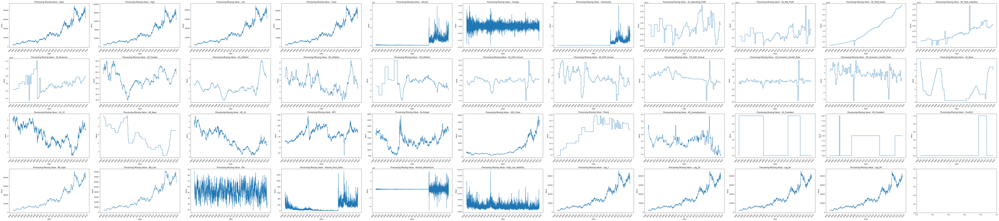

In [245]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/processed_data_1.jpg'
feature_dist(same, 90, 20, 'Date', 'Value', False, path)

### Plot - Interpolation

In [246]:
int = df_int
int = int.set_index('Date')
int

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.070090e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,235.560299,-31984.0,0.071642,3350.0,3350.0,3350.0,3350.0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.079520e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,224.671513,-31984.0,0.059347,3350.0,3350.0,3350.0,3350.0
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.088620e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,634.457143,1641105.0,0.055556,3370.0,3370.0,3370.0,3370.0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.097401e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,400.703590,-835504.0,0.056410,3780.0,3780.0,3780.0,3780.0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.121873e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,87.234267,218.018299,-716833.0,0.033505,3900.0,3900.0,3900.0,3900.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-24,62800,63400,62400,63200,26957500,0.009585,1703714000000,3.279430e+14,1.010090e+13,3.862814e+14,...,79694.052019,59335.947981,26.061574,426.542722,-1584876.0,0.015823,62600.0,62600.0,62600.0,62600.0
2024-09-25,63800,64200,62200,62200,28652438,-0.015823,1782181643600,3.393928e+14,1.010090e+13,3.862814e+14,...,78665.401755,58814.598245,24.370687,460.650129,1694938.0,0.032154,63200.0,63200.0,63200.0,63200.0
2024-09-26,63900,64900,63700,64700,37566015,0.040193,2430521170500,3.511122e+14,1.010090e+13,3.862814e+14,...,77638.072666,58701.927334,35.616990,580.618470,8913577.0,0.018547,62200.0,62200.0,62200.0,62200.0


In [295]:
int['SE_Operating_Profit']

,SE_Operating_Profit
Date,
2001-01-02,9.070090e+12
2001-01-03,9.079520e+12
2001-01-04,9.088620e+12
2001-01-05,9.097401e+12
2001-01-08,9.121873e+12
...,...
2024-09-24,3.279430e+14
2024-09-25,3.393928e+14
2024-09-26,3.511122e+14


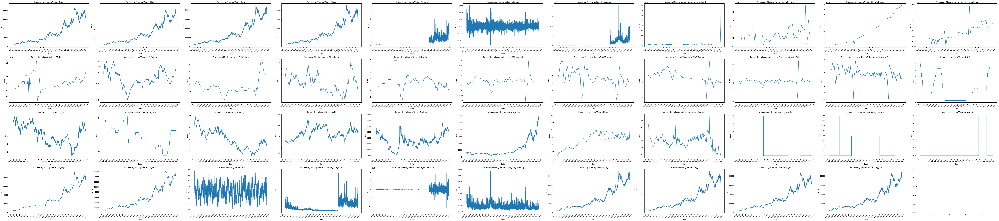

In [247]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/processed_data_inter.jpg'
feature_dist(int, 90,20, 'Date', 'Value', False, path)

# Detecting and managing outliers - Failure

In [ ]:
import scipy.stats as stats
import seaborn as sns
from scipy.stats.mstats import winsorize

### Chauvenet's Criterion

In [ ]:
def chauvenet_criterion(data): #data means feature data
    mean = np.mean(data)
    std = np.std(data)
    N = len(data)

    z = np.abs(data - mean) / std
    prob = 1 - stats.norm.cdf(z)
    threshold = 1.0 / (2 * N)

    outliers = data[prob < threshold]
    outlier_indices = data.isin(outliers)

    #print(f"{data.name} - Outliers identified by Chauvenet's Criterion:", outliers)

    return outliers, outlier_indices

def plot_chauvenet(dict, data, x_size, y_size, path, grid_flag = False):
    date = data.index
    fig, axes = plt.subplots(nrows = 10, ncols = 3, figsize=(x_size, y_size))
    axes = axes.flatten()

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            outliers, outlier_indices = chauvenet_criterion(feat)
            dict[f'{feat.name}'] = outliers

            ax = axes[i]
            label = f'{feat.name}'
            ax.plot(date, feat, marker = 'o', linestyle = '-', label = label)

            if not outliers.empty:
                ax.scatter(date[outlier_indices], feat[outlier_indices], color='red', marker='x', s=100, label='Outliers', zorder=5)

            ax.xaxis.set_major_locator(mdates.YearLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

            ax.set_title(f'Outliers identified by Chauvenet - {feat.name}')
            ax.set_xlabel('Date')
            ax.set_ylabel('Value')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(grid_flag)

            if not outliers.empty:  # 아웃라이어가 있는 경우에만 legend 추가
                ax.legend()

    plt.tight_layout()
    plt.savefig(path)
    plt.show()

#### Same

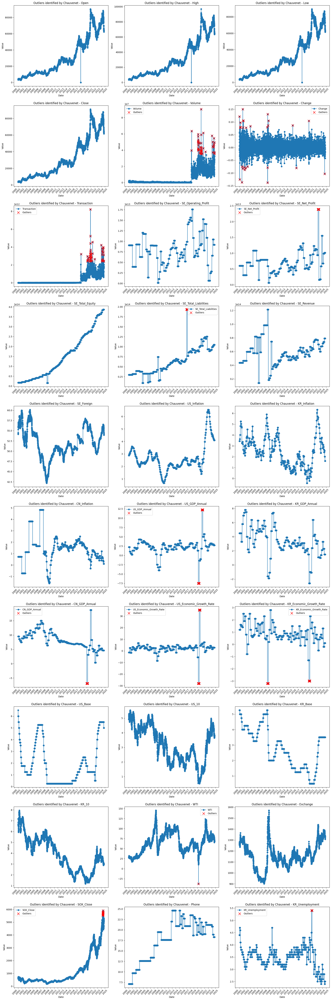

In [ ]:
chauvenet_dict = {}
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/chauvenet.jpg'
plot_chauvenet(chauvenet_dict, same, 20, 60, path)

In [ ]:
chauvenet_dict.keys()

dict_keys(['Open', 'High', 'Low', 'Close', 'Volume', 'Change', 'Transaction', 'SE_Operating_Profit', 'SE_Net_Profit', 'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'SE_Foreign', 'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual', 'KR_GDP_Annual', 'CN_GDP_Annual', 'US_Economic_Growth_Rate', 'KR_Economic_Growth_Rate', 'US_Base', 'US_10', 'KR_Base', 'KR_10', 'WTI', 'Exchange', 'SOX_Close', 'Phone', 'KR_Unemployment'])

#### Inter

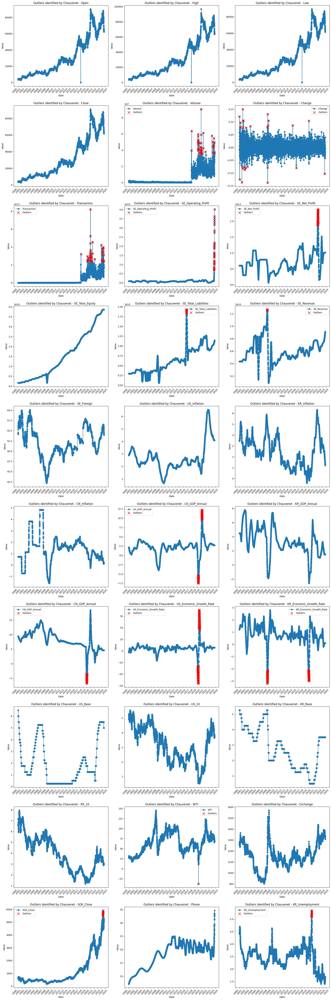

In [ ]:
chauvenet_dict_i = {}
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/chauvenet_inter.jpg'
plot_chauvenet(chauvenet_dict_i, int, 20, 60, path)

### Winsorizing - 0.05

In [ ]:
def plot_winsorizing(data, x_size, y_size, path, grid_flag = False):
    fig,axes = plt.subplots(nrows = 10, ncols = 3, figsize = (x_size, y_size))
    axes = axes.flatten()

    date = data.index

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            data_values = feat.values
            winsorized_data = winsorize(data_values, limits = [0.05, 0.05])

            ax = axes[i]
            ax.plot(date, feat, label = 'Original Data', color = 'b', linestyle = '-', marker = 'o')
            ax.plot(date, winsorized_data, label = 'Winsorized Data', color = 'r', linestyle = '--', marker = 'x')

            ax.xaxis.set_major_locator(mdates.YearLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

            ax.set_title(f'Outliers identified by Winsorizing - {feat.name}')
            ax.set_xlabel('Date')
            ax.set_ylabel('Value')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(grid_flag)
            ax.legend()

    plt.tight_layout()
    plt.savefig(path)
    plt.show()

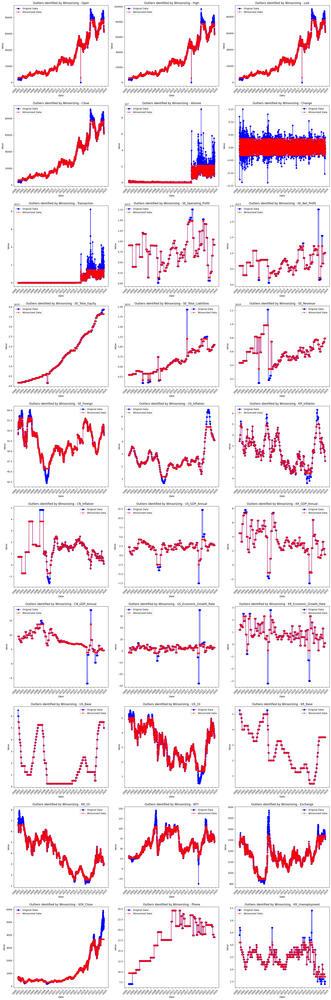

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing.jpg'
plot_winsorizing(same, 20, 60, path)

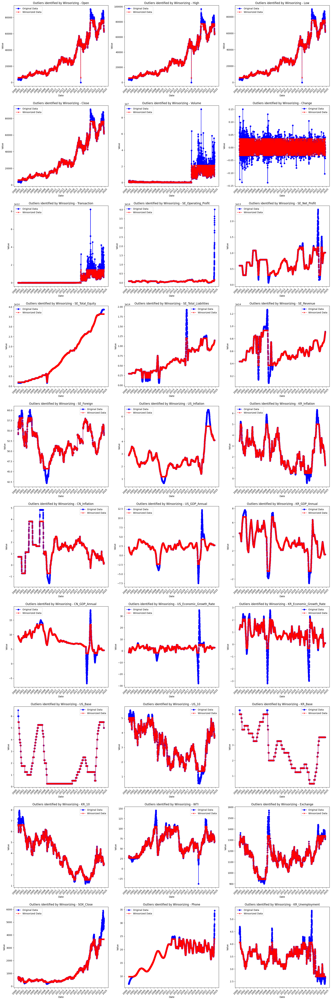

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_int.jpg'
plot_winsorizing(int, 20, 60, path)

### Winsorizing - 0.03

In [ ]:
def plot_winsorizing(data, x_size, y_size, path, grid_flag = False):
    fig,axes = plt.subplots(nrows = 10, ncols = 3, figsize = (x_size, y_size))
    axes = axes.flatten()

    date = data.index

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            data_values = feat.values
            winsorized_data = winsorize(data_values, limits = [0.03, 0.03])

            ax = axes[i]
            ax.plot(date, feat, label = 'Original Data', color = 'b', linestyle = '-', marker = 'o')
            ax.plot(date, winsorized_data, label = 'Winsorized Data', color = 'r', linestyle = '--', marker = 'x')

            ax.xaxis.set_major_locator(mdates.YearLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

            ax.set_title(f'Outliers identified by Winsorizing - {feat.name}')
            ax.set_xlabel('Date')
            ax.set_ylabel('Value')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(grid_flag)
            ax.legend()

    plt.tight_layout()
    plt.savefig(path)
    plt.show()

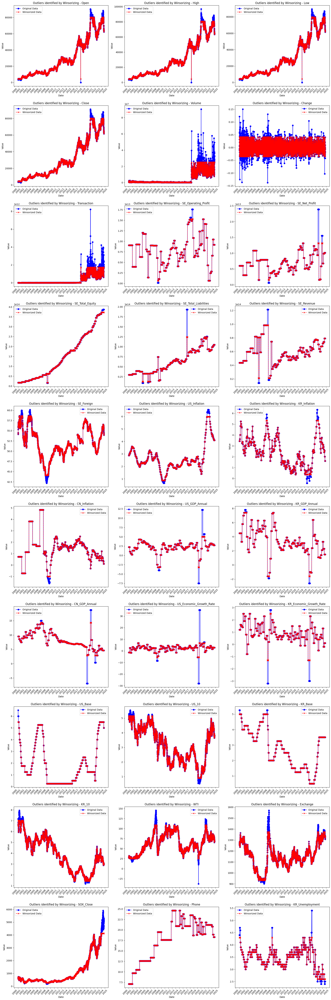

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_03.jpg'
plot_winsorizing(same, 20, 60, path)

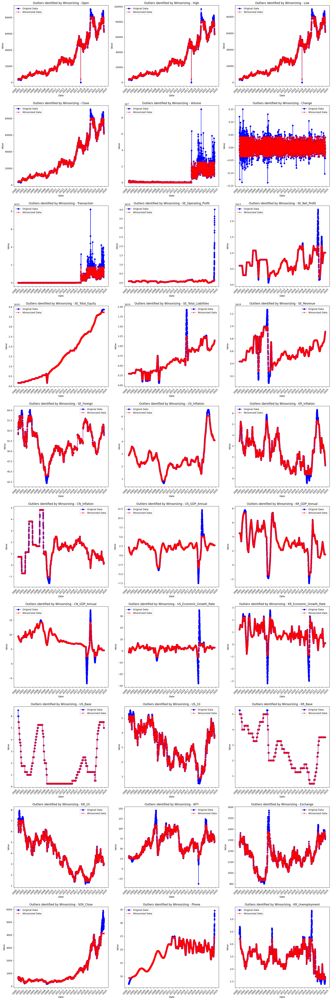

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_int_03.jpg'
plot_winsorizing(int, 20, 60, path)

### Winsorizing - 0.02

In [ ]:
def plot_winsorizing(data, x_size, y_size, path, grid_flag = False):
    fig,axes = plt.subplots(nrows = 10, ncols = 3, figsize = (x_size, y_size))
    axes = axes.flatten()

    date = data.index

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            data_values = feat.values
            winsorized_data = winsorize(data_values, limits = [0.02, 0.02])

            ax = axes[i]
            ax.plot(date, feat, label = 'Original Data', color = 'b', linestyle = '-', marker = 'o')
            ax.plot(date, winsorized_data, label = 'Winsorized Data', color = 'r', linestyle = '--', marker = 'x')

            ax.xaxis.set_major_locator(mdates.YearLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

            ax.set_title(f'Outliers identified by Winsorizing - {feat.name}')
            ax.set_xlabel('Date')
            ax.set_ylabel('Value')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(grid_flag)
            ax.legend()

    plt.tight_layout()
    plt.savefig(path)
    plt.show()

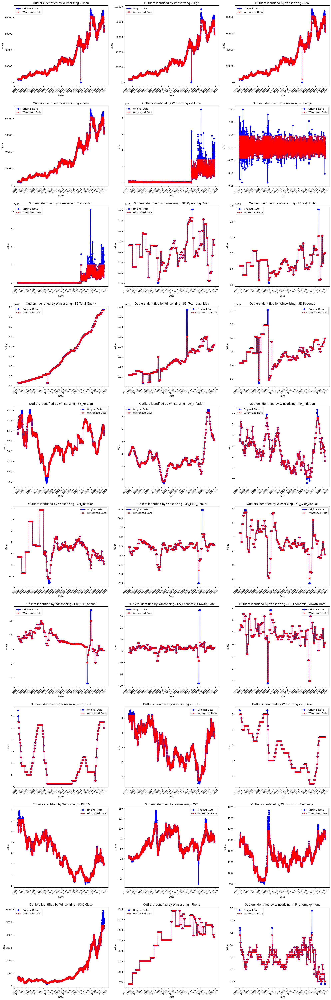

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_02.jpg'
plot_winsorizing(same, 20, 60, path)

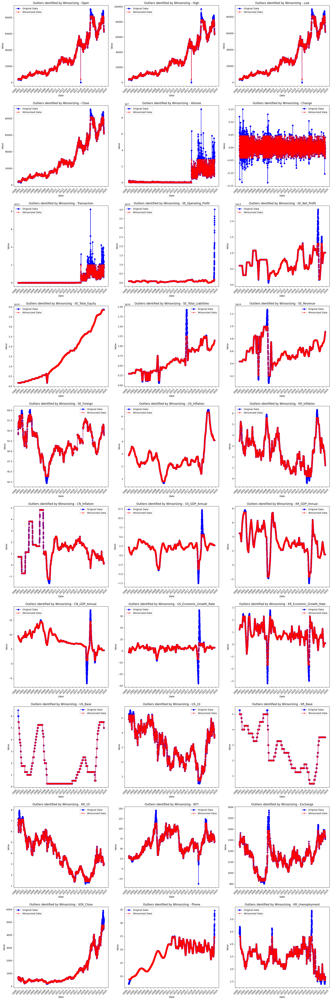

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_int_02.jpg'
plot_winsorizing(int, 20, 60, path)

### Winsorizing - 0.01

In [ ]:
def plot_winsorizing(data, x_size, y_size, path, winsorized, grid_flag = False):
    fig,axes = plt.subplots(nrows = 10, ncols = 3, figsize = (x_size, y_size))
    axes = axes.flatten()

    date = data.index
    winsorized_data_dict = {}

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            data_values = feat.values
            winsorized_data = winsorize(data_values, limits = [0.01, 0.01])
            winsorized_data_dict[feat.name] = winsorized_data  # 이름을 키로 사용하여 저장

            ax = axes[i]
            ax.plot(date, feat, label = 'Original Data', color = 'b', linestyle = '-', marker = 'o')
            ax.plot(date, winsorized_data, label = 'Winsorized Data', color = 'r', linestyle = '--', marker = 'x')

            ax.xaxis.set_major_locator(mdates.YearLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

            ax.set_title(f'Outliers identified by Winsorizing - {feat.name}')
            ax.set_xlabel('Date')
            ax.set_ylabel('Value')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(grid_flag)
            ax.legend()

    # 한 번에 데이터프레임에 추가
    winsorized = pd.concat([winsorized, pd.DataFrame(winsorized_data_dict, index=data.index)], axis=1)

    plt.tight_layout()
    plt.savefig(path)
    plt.show()

In [ ]:
winsorized = same.copy()

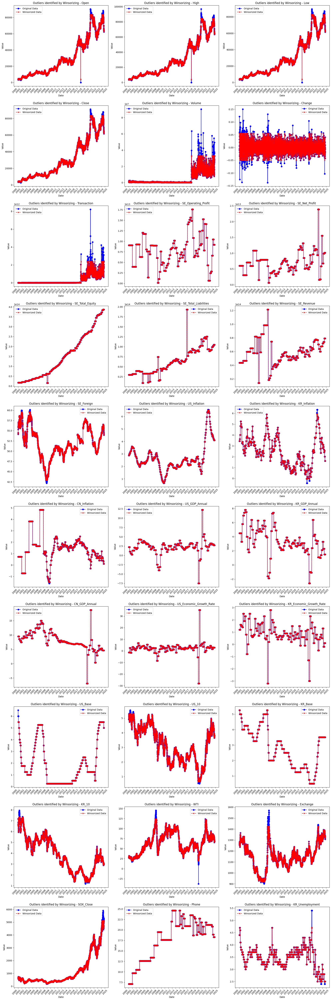

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_01.jpg'
plot_winsorizing(same, 20, 60, path, winsorized)

In [ ]:
winsorized.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.1,4.4,1.0,1.0,0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.1,4.4,1.0,1.0,0
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.1,4.4,1.0,1.0,0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.1,4.4,1.0,1.0,0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.1,4.4,1.0,1.0,0


In [ ]:
winsorized.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorized_same.csv')

In [ ]:
winsorized_int = int.copy()

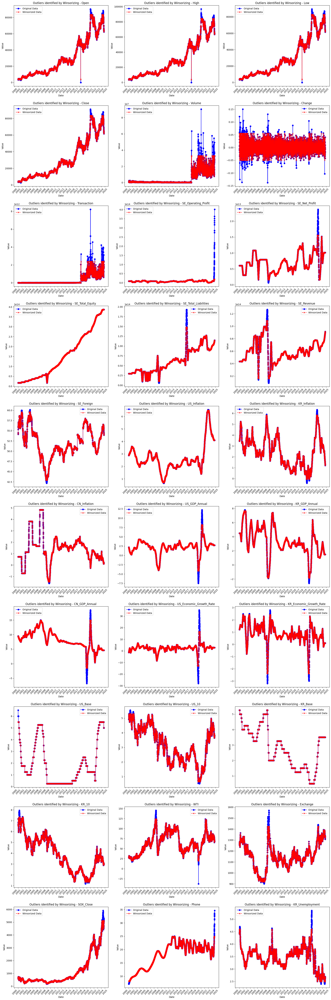

In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_int_01.jpg'
plot_winsorizing(int, 20, 60, path, winsorized_int)

In [ ]:
winsorized_int.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.070090e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.114173,4.409677,1.0,1.0,0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.079520e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.128294,4.419355,1.0,1.0,0
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.088620e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.142364,4.429032,1.0,1.0,0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.097401e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.156383,4.438710,1.0,1.0,0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.121873e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.198134,4.467742,1.0,1.0,0


In [ ]:
winsorized_int.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorized_int.csv')

### Winsorizing - Umm...

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import zscore
from scipy.stats import shapiro
import statsmodels.api as sm
from scipy.stats import iqr


def plot_winsorizing_and_compare(data, x_size, y_size, path, limits_list=[[0.02, 0.02], [0.03, 0.03], [0.05, 0.05]], grid_flag=False):
    fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(x_size, y_size))
    axes = axes.flatten()

    date = data.index
    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            original_data = feat.values
            results = {}

            # Apply Winsorizing for each set of limits
            for limits in limits_list:
                winsorized_data = winsorize(original_data, limits=limits)
                results[f"winsor_{limits[0]}"] = winsorized_data

            # Plotting all results
            ax = axes[i]
            ax.plot(date, original_data, label='Original Data', color='b', linestyle='-', marker='o')
            for limits, winsorized_data in results.items():
                ax.plot(date, winsorized_data, label=f'Winsorized {limits[0]}', linestyle='--', marker='x')

            ax.xaxis.set_major_locator(mdates.YearLocator())
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))
            ax.set_title(f'Winsorizing Comparison - {feat.name}')
            ax.set_xlabel('Date')
            ax.set_ylabel('Value')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(grid_flag)
            ax.legend()

            # Statistical Evaluation
            eval_results = {"Shapiro Original": shapiro(feat)[1]}
            eval_results["Shapiro 0.02"] = shapiro(results["winsor_0.02"])[1]
            eval_results["Shapiro 0.03"] = shapiro(results["winsor_0.03"])[1]
            eval_results["Shapiro 0.05"] = shapiro(results["winsor_0.05"])[1]

            # Z-Score Evaluation
            z_scores_original = zscore(feat)
            z_scores_0_02 = zscore(results["winsor_0.02"])
            z_scores_0_03 = zscore(results["winsor_0.03"])
            z_scores_0_05 = zscore(results["winsor_0.05"])

            eval_results["Z-Score Original"] = np.sum(np.abs(z_scores_original) > 3)
            eval_results["Z-Score 0.02"] = np.sum(np.abs(z_scores_0_02) > 3)
            eval_results["Z-Score 0.03"] = np.sum(np.abs(z_scores_0_03) > 3)
            eval_results["Z-Score 0.05"] = np.sum(np.abs(z_scores_0_05) > 3)

            # IQR Evaluation
            iqr_original = iqr(feat)
            iqr_0_02 = iqr(results["winsor_0.02"])
            iqr_0_03 = iqr(results["winsor_0.03"])
            iqr_0_05 = iqr(results["winsor_0.05"])

            eval_results["IQR Original"] = iqr_original
            eval_results["IQR 0.02"] = iqr_0_02
            eval_results["IQR 0.03"] = iqr_0_03
            eval_results["IQR 0.05"] = iqr_0_05

            # Print Evaluation Results
            print(f"Feature: {feat.name}")
            for key, value in eval_results.items():
                print(f"  - {key}: {value}")

    plt.tight_layout()
    plt.savefig(path)
    plt.show()


In [ ]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/Winsorizing_same_umm.jpg'
plot_winsorizing_and_compare(same, 20, 60, path)

Output hidden; open in https://colab.research.google.com to view.

# Detecting and managing outliers

In [248]:
df_same.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Change',
       'Transaction', 'SE_Operating_Profit', 'SE_Net_Profit',
       'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'SE_Foreign',
       'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual',
       'KR_GDP_Annual', 'CN_GDP_Annual', 'US_Economic_Growth_Rate',
       'KR_Economic_Growth_Rate', 'US_Base', 'US_10', 'KR_Base', 'KR_10',
       'WTI', 'Exchange', 'SOX_Close', 'Phone', 'KR_Unemployment',
       'US_President', 'KR_President', 'Covid19', 'BB_High', 'BB_Low', 'RSI',
       'Volume_Price_Ratio', 'Volume_Momentum', 'High_Low_Volatility', 'Lag_1',
       'Lag_30', 'Lag_60', 'Lag_90'],
      dtype='object')

https://colab.research.google.com/drive/1A1FQEx0Bt3nt62mFlvtgpVrCe4xJB9dm

In [264]:
outlier_same = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/robust_outlier_same.csv')
outlier_int = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/robust_outlier_int.csv')

In [265]:
outlier_same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
0,3160,3380,3140,3350,789127,0.005970,2643575450,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,235.560299,-31984.0,0.045255,3350.0,3350.0,3350.0,3350.0
1,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,224.671513,-31984.0,0.045255,3350.0,3350.0,3350.0,3350.0
2,3790,3870,3660,3780,2398248,0.018858,9065377440,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,544.318757,1641105.0,0.045255,3370.0,3350.0,3350.0,3350.0
3,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,400.703590,-835504.0,0.045255,3780.0,3350.0,3350.0,3350.0
4,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,218.018299,-716833.0,0.033505,3900.0,3350.0,3350.0,3350.0


In [266]:
outlier_same.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5862 entries, 0 to 5861
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Open                     5862 non-null   int64  
 1   High                     5862 non-null   int64  
 2   Low                      5862 non-null   int64  
 3   Close                    5862 non-null   int64  
 4   Volume                   5862 non-null   int64  
 5   Change                   5862 non-null   float64
 6   Transaction              5862 non-null   int64  
 7   SE_Operating_Profit      5862 non-null   float64
 8   SE_Net_Profit            5862 non-null   float64
 9   SE_Total_Equity          5862 non-null   float64
 10  SE_Total_Liabilities     5862 non-null   float64
 11  SE_Revenue               5862 non-null   float64
 12  SE_Foreign               5862 non-null   float64
 13  US_Inflation             5862 non-null   float64
 14  KR_Inflation            

In [267]:
outlier_same = outlier_same.set_index(same.index)
outlier_int = outlier_int.set_index(int.index)
outlier_same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.005970,2643575450,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,235.560299,-31984.0,0.045255,3350.0,3350.0,3350.0,3350.0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,224.671513,-31984.0,0.045255,3350.0,3350.0,3350.0,3350.0
2001-01-04,3790,3870,3660,3780,2398248,0.018858,9065377440,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,544.318757,1641105.0,0.045255,3370.0,3350.0,3350.0,3350.0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,400.703590,-835504.0,0.045255,3780.0,3350.0,3350.0,3350.0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,218.018299,-716833.0,0.033505,3900.0,3350.0,3350.0,3350.0


In [268]:
outlier_int.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.005970,2643575450,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,235.560299,-31984.0,0.045255,3350.0,3350.0,3350.0,3350.0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,224.671513,-31984.0,0.045255,3350.0,3350.0,3350.0,3350.0
2001-01-04,3790,3870,3660,3780,2398248,0.018858,9065377440,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,544.318757,1641105.0,0.045255,3370.0,3350.0,3350.0,3350.0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,400.703590,-835504.0,0.045255,3780.0,3350.0,3350.0,3350.0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,1.678550e+13,...,4674.156324,3317.843676,84.482496,218.018299,-716833.0,0.033505,3900.0,3350.0,3350.0,3350.0


In [ ]:
# outlier_same.drop(columns = ['Date'], inplace = True)
# outlier_same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2.643575e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.1,4.4,1,1,0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2.551572e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.1,4.4,1,1,0
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9.065377e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.1,4.4,1,1,0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6.094702e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.1,4.4,1,1,0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3.282135e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.1,4.4,1,1,0


In [ ]:
# outlier_int.drop(columns = ['Date'], inplace = True)
# outlier_int.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2.643575e+09,9.070090e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.114173,4.409677,1,1,False
2001-01-03,3229,3420,3220,3370,757143,0.005970,2.551572e+09,9.079520e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.128294,4.419355,1,1,False
2001-01-04,3790,3870,3660,3780,2398248,0.018858,9.065377e+09,9.088620e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.142364,4.429032,1,1,False
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6.094702e+09,9.097400e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.156383,4.438710,1,1,False
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3.282135e+09,9.121870e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.198134,4.467742,1,1,False


In [ ]:
# same.index

DatetimeIndex(['2001-01-02', '2001-01-03', '2001-01-04', '2001-01-05',
               '2001-01-08', '2001-01-09', '2001-01-10', '2001-01-11',
               '2001-01-12', '2001-01-15',
               ...
               '2024-09-12', '2024-09-13', '2024-09-19', '2024-09-20',
               '2024-09-23', '2024-09-24', '2024-09-25', '2024-09-26',
               '2024-09-27', '2024-09-30'],
              dtype='datetime64[ns]', name='Date', length=5865, freq=None)

In [ ]:
# outlier_same.index = same.index
# outlier_same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2.643575e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.1,4.4,1,1,0
2001-01-03,3229,3420,3220,3370,757143,0.005970,2.551572e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.1,4.4,1,1,0
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9.065377e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.1,4.4,1,1,0
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6.094702e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.1,4.4,1,1,0
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3.282135e+09,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.1,4.4,1,1,0


In [ ]:
# outlier_int.index = same.index
# outlier_int.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2.643575e+09,9.070090e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.114173,4.409677,1,1,False
2001-01-03,3229,3420,3220,3370,757143,0.005970,2.551572e+09,9.079520e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.128294,4.419355,1,1,False
2001-01-04,3790,3870,3660,3780,2398248,0.018858,9.065377e+09,9.088620e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.142364,4.429032,1,1,False
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6.094702e+09,9.097400e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.156383,4.438710,1,1,False
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3.282135e+09,9.121870e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.198134,4.467742,1,1,False


# Normalization and scaling techniques(Standardization) + Log
-> We choose to use standardization

In [255]:
from sklearn.preprocessing import StandardScaler

In [269]:
outlier_same.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Open                     5862 non-null   int64  
 1   High                     5862 non-null   int64  
 2   Low                      5862 non-null   int64  
 3   Close                    5862 non-null   int64  
 4   Volume                   5862 non-null   int64  
 5   Change                   5862 non-null   float64
 6   Transaction              5862 non-null   int64  
 7   SE_Operating_Profit      5862 non-null   float64
 8   SE_Net_Profit            5862 non-null   float64
 9   SE_Total_Equity          5862 non-null   float64
 10  SE_Total_Liabilities     5862 non-null   float64
 11  SE_Revenue               5862 non-null   float64
 12  SE_Foreign               5862 non-null   float64
 13  US_Inflation             5862 non-null   float64
 14  KR_Inf

In [270]:
outlier_int.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Open                     5862 non-null   int64  
 1   High                     5862 non-null   int64  
 2   Low                      5862 non-null   int64  
 3   Close                    5862 non-null   int64  
 4   Volume                   5862 non-null   int64  
 5   Change                   5862 non-null   float64
 6   Transaction              5862 non-null   int64  
 7   SE_Operating_Profit      5862 non-null   float64
 8   SE_Net_Profit            5862 non-null   float64
 9   SE_Total_Equity          5862 non-null   float64
 10  SE_Total_Liabilities     5862 non-null   float64
 11  SE_Revenue               5862 non-null   float64
 12  SE_Foreign               5862 non-null   float64
 13  US_Inflation             5862 non-null   float64
 14  KR_Inf

In [272]:
outlier_same['US_President'] = outlier_same['US_President'].astype('category')
outlier_same['KR_President'] = outlier_same['KR_President'].astype('category')
outlier_same.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Open                     5862 non-null   int64   
 1   High                     5862 non-null   int64   
 2   Low                      5862 non-null   int64   
 3   Close                    5862 non-null   int64   
 4   Volume                   5862 non-null   int64   
 5   Change                   5862 non-null   float64 
 6   Transaction              5862 non-null   int64   
 7   SE_Operating_Profit      5862 non-null   float64 
 8   SE_Net_Profit            5862 non-null   float64 
 9   SE_Total_Equity          5862 non-null   float64 
 10  SE_Total_Liabilities     5862 non-null   float64 
 11  SE_Revenue               5862 non-null   float64 
 12  SE_Foreign               5862 non-null   float64 
 13  US_Inflation             5862 non-null   floa

In [271]:
outlier_int['US_President'] = outlier_int['US_President'].astype('category')
outlier_int['KR_President'] = outlier_int['KR_President'].astype('category')
outlier_int.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Open                     5862 non-null   int64   
 1   High                     5862 non-null   int64   
 2   Low                      5862 non-null   int64   
 3   Close                    5862 non-null   int64   
 4   Volume                   5862 non-null   int64   
 5   Change                   5862 non-null   float64 
 6   Transaction              5862 non-null   int64   
 7   SE_Operating_Profit      5862 non-null   float64 
 8   SE_Net_Profit            5862 non-null   float64 
 9   SE_Total_Equity          5862 non-null   float64 
 10  SE_Total_Liabilities     5862 non-null   float64 
 11  SE_Revenue               5862 non-null   float64 
 12  SE_Foreign               5862 non-null   float64 
 13  US_Inflation             5862 non-null   floa

In [273]:
log_cols = ['Open', 'High', 'Low', 'Close', 'Volume', 'Transaction', 'SE_Operating_Profit', 'SE_Net_Profit', 'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'SE_Foreign', 'SOX_Close', 'Phone', 'BB_High', 'BB_Low', 'RSI', 'Volume_Price_Ratio', 'High_Low_Volatility', 'Lag_1', 'Lag_30', 'Lag_60', 'Lag_90']
standardize_cols = ['Change', 'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual', 'KR_GDP_Annual', 'CN_GDP_Annual', 'US_Economic_Growth_Rate', 'KR_Economic_Growth_Rate', 'US_Base', 'US_10', 'KR_Base', 'KR_10', 'WTI', 'Exchange', 'KR_Unemployment', 'Volume_Momentum']

In [274]:
def log_scale_transform(data, log_cols, standardize_cols):
    log_transformed_data = np.log(data[log_cols].replace(0, 1e-10))
    log = pd.DataFrame(log_transformed_data, columns=log_cols, index=data.index)

    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[standardize_cols])
    scaled = pd.DataFrame(scaled_data, columns=standardize_cols, index=data.index)

    unchanged_cols = data.columns.difference(log_cols + standardize_cols)
    unchanged_df = data[unchanged_cols]

    log_scale = pd.concat([log, scaled, unchanged_df], axis=1)

    log_scale = log_scale[data.columns]

    return log_scale

In [275]:
same_log_scale = log_scale_transform(outlier_same, log_cols, standardize_cols)
same_log_scale.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304463,21.695398,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.461967,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304463,21.659975,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.414639,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027374,22.927728,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,6.299535,0.638441,-3.095450,8.122668,8.116716,8.116716,8.116716
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750286,22.530686,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.993222,-0.324828,-3.095450,8.237479,8.116716,8.116716,8.116716
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318066,21.911760,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.384579,-0.278671,-3.396056,8.268732,8.116716,8.116716,8.116716


In [276]:
same_log_scale.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Open                     5862 non-null   float64 
 1   High                     5862 non-null   float64 
 2   Low                      5862 non-null   float64 
 3   Close                    5862 non-null   float64 
 4   Volume                   5862 non-null   float64 
 5   Change                   5862 non-null   float64 
 6   Transaction              5862 non-null   float64 
 7   SE_Operating_Profit      5862 non-null   float64 
 8   SE_Net_Profit            5862 non-null   float64 
 9   SE_Total_Equity          5862 non-null   float64 
 10  SE_Total_Liabilities     5862 non-null   float64 
 11  SE_Revenue               5862 non-null   float64 
 12  SE_Foreign               5862 non-null   float64 
 13  US_Inflation             5862 non-null   floa

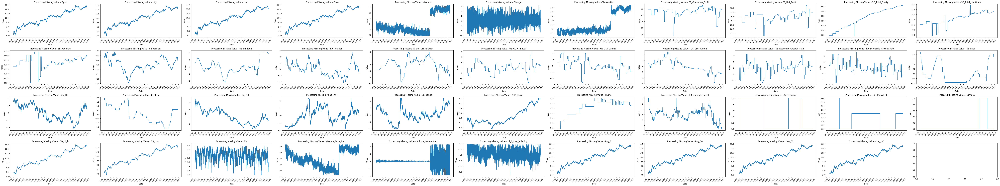

In [277]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/scaled_same.jpg'
feature_dist(same_log_scale, 80, 15, 'Date', 'Value', False, path)

In [278]:
int_log_scale = log_scale_transform(outlier_int, log_cols, standardize_cols)
int_log_scale.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304463,21.695398,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.461967,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304463,21.659975,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.414639,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027374,22.927728,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,6.299535,0.638441,-3.095450,8.122668,8.116716,8.116716,8.116716
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750286,22.530686,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.993222,-0.324828,-3.095450,8.237479,8.116716,8.116716,8.116716
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318066,21.911760,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.384579,-0.278671,-3.396056,8.268732,8.116716,8.116716,8.116716


In [279]:
int_log_scale.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Open                     5862 non-null   float64 
 1   High                     5862 non-null   float64 
 2   Low                      5862 non-null   float64 
 3   Close                    5862 non-null   float64 
 4   Volume                   5862 non-null   float64 
 5   Change                   5862 non-null   float64 
 6   Transaction              5862 non-null   float64 
 7   SE_Operating_Profit      5862 non-null   float64 
 8   SE_Net_Profit            5862 non-null   float64 
 9   SE_Total_Equity          5862 non-null   float64 
 10  SE_Total_Liabilities     5862 non-null   float64 
 11  SE_Revenue               5862 non-null   float64 
 12  SE_Foreign               5862 non-null   float64 
 13  US_Inflation             5862 non-null   floa

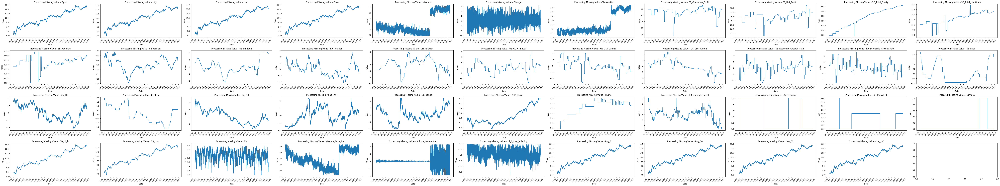

In [280]:
path = '/content/drive/MyDrive/Time Series Project/Stock Price/data/scaled_int.jpg'
feature_dist(int_log_scale, 80, 15, 'Date', 'Value', False, path)

In [281]:
same_log_scale.index

DatetimeIndex(['2001-01-02', '2001-01-03', '2001-01-04', '2001-01-05',
               '2001-01-08', '2001-01-09', '2001-01-10', '2001-01-11',
               '2001-01-12', '2001-01-15',
               ...
               '2024-09-12', '2024-09-13', '2024-09-19', '2024-09-20',
               '2024-09-23', '2024-09-24', '2024-09-25', '2024-09-26',
               '2024-09-27', '2024-09-30'],
              dtype='datetime64[ns]', name='Date', length=5862, freq=None)

In [282]:
same_log_scale.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/scaled_same.csv')
int_log_scale.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/scaled_int.csv')

In [283]:
int_log_scale.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 43 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Open                     5862 non-null   float64 
 1   High                     5862 non-null   float64 
 2   Low                      5862 non-null   float64 
 3   Close                    5862 non-null   float64 
 4   Volume                   5862 non-null   float64 
 5   Change                   5862 non-null   float64 
 6   Transaction              5862 non-null   float64 
 7   SE_Operating_Profit      5862 non-null   float64 
 8   SE_Net_Profit            5862 non-null   float64 
 9   SE_Total_Equity          5862 non-null   float64 
 10  SE_Total_Liabilities     5862 non-null   float64 
 11  SE_Revenue               5862 non-null   float64 
 12  SE_Foreign               5862 non-null   float64 
 13  US_Inflation             5862 non-null   floa

In [285]:
# 'column_name'에서 NaN이 있는 index 찾기
nan_indexes = int_log_scale[same_log_scale['SE_Operating_Profit'].isna()].index

# 결과 출력
print(nan_indexes)


DatetimeIndex([], dtype='datetime64[ns]', name='Date', freq=None)


to make bf outlier + scaling

In [299]:
mk_same_log_scale = log_scale_transform(df_same, log_cols, standardize_cols)
mk_same_log_scale.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
99,2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,2.966717,21.695398,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.461967,-0.011072,-2.636077,8.116716,8.116716,8.116716,8.116716
100,2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.262797,21.659975,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.414639,-0.011072,-2.824351,8.116716,8.116716,8.116716,8.116716
101,2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,6.039041,22.927728,29.834928,29.42326,...,8.449804,8.10707,4.468597,6.452770,0.483975,-2.890372,8.122668,8.116716,8.116716,8.116716
102,2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.549734,22.530686,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.993222,-0.248825,-2.875104,8.237479,8.116716,8.116716,8.116716
103,2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.291321,21.911760,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.384579,-0.213711,-3.396056,8.268732,8.116716,8.116716,8.116716


In [300]:
mk_int_log_scale = log_scale_transform(df_int, log_cols, standardize_cols)
mk_same_log_scale.head()

,Date,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
99,2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,2.966717,21.695398,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.461967,-0.011072,-2.636077,8.116716,8.116716,8.116716,8.116716
100,2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.262797,21.659975,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.414639,-0.011072,-2.824351,8.116716,8.116716,8.116716,8.116716
101,2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,6.039041,22.927728,29.834928,29.42326,...,8.449804,8.10707,4.468597,6.452770,0.483975,-2.890372,8.122668,8.116716,8.116716,8.116716
102,2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.549734,22.530686,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.993222,-0.248825,-2.875104,8.237479,8.116716,8.116716,8.116716
103,2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.291321,21.911760,29.834928,29.42326,...,8.449804,8.10707,4.468597,5.384579,-0.213711,-3.396056,8.268732,8.116716,8.116716,8.116716


In [301]:
mk_same_log_scale.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/mk_scaled_same.csv')
mk_int_log_scale.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/mk_scaled_int.csv')

# Any transformations applied (e.g., logarithmic, differencing) -> differencing

In [ ]:
from statsmodels.tsa.stattools import adfuller

In [ ]:
def plot_rolling(timeseries, ax, window = 252):
    rolmean = timeseries.rolling(window = window).mean()
    rolstd = timeseries.rolling(window = window).std()

    ax.xaxis.set_major_locator(mdates.YearLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y"))

    ax.plot(timeseries, color = 'blue', label = 'Original Time Series')
    ax.plot(rolmean, color = 'orange', label = f'Rolling Mean (Window = {window})')
    ax.plot(rolstd, color='black', label=f'Rolling Std (Window = {window})')

    ax.set_title('Original Time Series with Rolling Mean & Standard Deviation')
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.tick_params(axis = 'x', rotation = 45)
    ax.legend()

In [ ]:
def adf_test(data):
    dftest = adfuller(data, autolag = 'AIC')
    print(f'ADF Statistics: {dftest[0]:.4f}')
    print(f'P-Value: {dftest[1]:.4f}')
    print('Critical Values:')
    for key, value in dftest[4].items():
        print(f'   {key}: {value:4f}')
    print('=' * 30)

In [ ]:
def differencing(data, x_size, y_size):
    fig, axes = plt.subplots(nrows=3, ncols=10, figsize=(x_size, y_size))
    axes = axes.flatten()

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            print(f'ADF TEST FOR {feat.name}')
            adf_test(feat)

            ax = axes[i]
            plot_rolling(feat, ax)

    plt.tight_layout()
    plt.show()

In [ ]:
def differencing_1(data, x_size, y_size):
    fig, axes = plt.subplots(nrows=3, ncols=10, figsize=(x_size, y_size))
    axes = axes.flatten()

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            feat_shift = feat.shift()
            feat_diff = feat - feat_shift
            feat_diff.dropna(inplace = True)

            print(f'ADF TEST FOR {feat.name}')
            adf_test(feat_diff)

            ax = axes[i]
            plot_rolling(feat_diff, ax)

    plt.tight_layout()
    plt.show()

In [ ]:
def differencing_2(data, x_size, y_size):
    fig, axes = plt.subplots(nrows=3, ncols=10, figsize=(x_size, y_size))
    axes = axes.flatten()

    for i, feature in enumerate(data.columns):
        if i < 30:
            feat = data[feature]
            feat_shift = feat.shift(2)
            feat_diff = feat - feat_shift
            feat_diff.dropna(inplace = True)

            print(f'ADF TEST FOR {feat.name}')
            adf_test(feat_diff)

            ax = axes[i]
            plot_rolling(feat_diff, ax)

    plt.tight_layout()
    plt.show()

ADF TEST FOR Open
ADF Statistics: -3.4286
P-Value: 0.0100
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR High
ADF Statistics: -3.4310
P-Value: 0.0099
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Low
ADF Statistics: -3.4249
P-Value: 0.0101
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Close
ADF Statistics: -1.7008
P-Value: 0.4307
Critical Values:
   1%: -3.431466
   5%: -2.862033
   10%: -2.567033
ADF TEST FOR Volume
ADF Statistics: -0.9993
P-Value: 0.7535
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR Change
ADF Statistics: -36.6805
P-Value: 0.0000
Critical Values:
   1%: -3.431466
   5%: -2.862033
   10%: -2.567033
ADF TEST FOR Transaction
ADF Statistics: -0.5242
P-Value: 0.8872
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR SE_Operating_Profit
ADF Statistics: -4.3346
P-Value: 0.0004
Critical Values:
   1%: -3

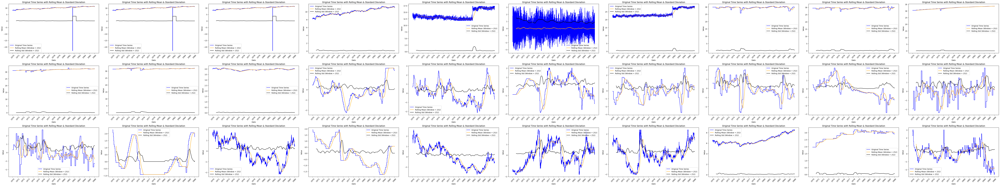

In [ ]:
differencing(same_log_scale, 80, 15)

ADF TEST FOR Open
ADF Statistics: -22.8065
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR High
ADF Statistics: -22.8035
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Low
ADF Statistics: -22.8080
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Close
ADF Statistics: -41.7842
P-Value: 0.0000
Critical Values:
   1%: -3.431466
   5%: -2.862033
   10%: -2.567033
ADF TEST FOR Volume
ADF Statistics: -23.2005
P-Value: 0.0000
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR Change
ADF Statistics: -22.9853
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Transaction
ADF Statistics: -23.3321
P-Value: 0.0000
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR SE_Operating_Profit
ADF Statistics: -76.5572
P-Value: 0.0000
Critical Values:
  

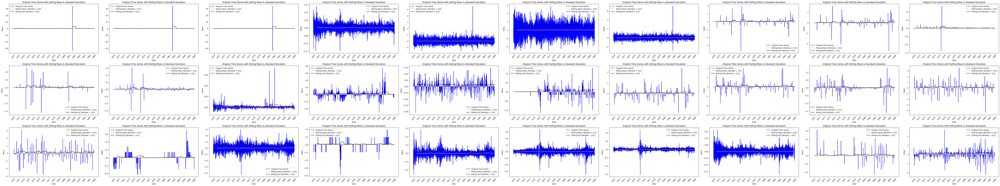

In [ ]:
differencing_1(same_log_scale, 80, 15)

ADF TEST FOR Open
ADF Statistics: -21.5329
P-Value: 0.0000
Critical Values:
   1%: -3.431473
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR High
ADF Statistics: -21.5257
P-Value: 0.0000
Critical Values:
   1%: -3.431473
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Low
ADF Statistics: -21.5316
P-Value: 0.0000
Critical Values:
   1%: -3.431473
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Close
ADF Statistics: -12.6283
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Volume
ADF Statistics: -16.5575
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Change
ADF Statistics: -23.2822
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Transaction
ADF Statistics: -16.5427
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR SE_Operating_Profit
ADF Statistics: -12.5116
P-Value: 0.0000
Critical Values:
  

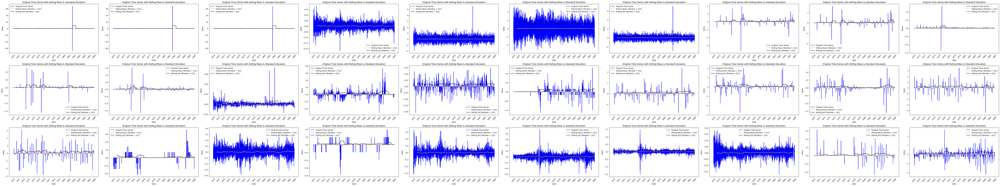

In [ ]:
differencing_2(same_log_scale, 80, 15)

ADF TEST FOR Open
ADF Statistics: -3.4286
P-Value: 0.0100
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR High
ADF Statistics: -3.4310
P-Value: 0.0099
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Low
ADF Statistics: -3.4249
P-Value: 0.0101
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Close
ADF Statistics: -1.7008
P-Value: 0.4307
Critical Values:
   1%: -3.431466
   5%: -2.862033
   10%: -2.567033
ADF TEST FOR Volume
ADF Statistics: -0.9993
P-Value: 0.7535
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR Change
ADF Statistics: -36.6805
P-Value: 0.0000
Critical Values:
   1%: -3.431466
   5%: -2.862033
   10%: -2.567033
ADF TEST FOR Transaction
ADF Statistics: -0.5242
P-Value: 0.8872
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR SE_Operating_Profit
ADF Statistics: -5.9664
P-Value: 0.0000
Critical Values:
   1%: -3

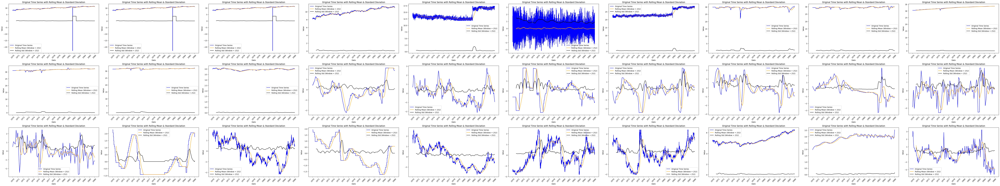

In [ ]:
differencing(int_log_scale, 80, 15)

ADF TEST FOR Open
ADF Statistics: -22.8065
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR High
ADF Statistics: -22.8035
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Low
ADF Statistics: -22.8080
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Close
ADF Statistics: -41.7842
P-Value: 0.0000
Critical Values:
   1%: -3.431466
   5%: -2.862033
   10%: -2.567033
ADF TEST FOR Volume
ADF Statistics: -23.2005
P-Value: 0.0000
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR Change
ADF Statistics: -22.9853
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Transaction
ADF Statistics: -23.3321
P-Value: 0.0000
Critical Values:
   1%: -3.431470
   5%: -2.862035
   10%: -2.567033
ADF TEST FOR SE_Operating_Profit
ADF Statistics: -9.2851
P-Value: 0.0000
Critical Values:
   

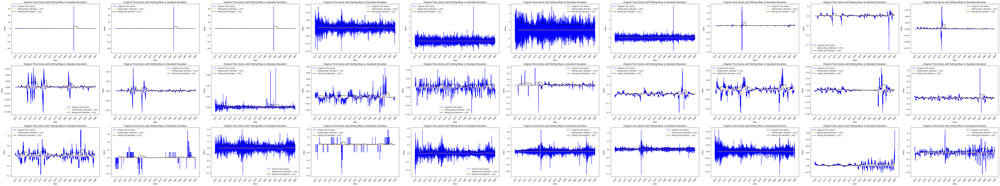

In [ ]:
differencing_1(int_log_scale, 80, 15)

ADF TEST FOR Open
ADF Statistics: -21.5329
P-Value: 0.0000
Critical Values:
   1%: -3.431473
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR High
ADF Statistics: -21.5257
P-Value: 0.0000
Critical Values:
   1%: -3.431473
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Low
ADF Statistics: -21.5316
P-Value: 0.0000
Critical Values:
   1%: -3.431473
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Close
ADF Statistics: -12.6283
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Volume
ADF Statistics: -16.5575
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Change
ADF Statistics: -23.2822
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR Transaction
ADF Statistics: -16.5427
P-Value: 0.0000
Critical Values:
   1%: -3.431472
   5%: -2.862036
   10%: -2.567034
ADF TEST FOR SE_Operating_Profit
ADF Statistics: -9.3385
P-Value: 0.0000
Critical Values:
   

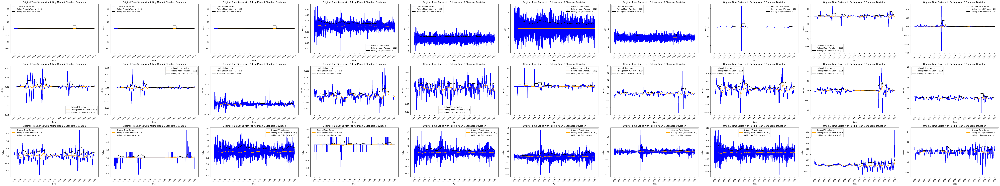

In [ ]:
differencing_2(int_log_scale, 80, 15)

# Additional steps required for modeling preparation, if any

### PCA, corr

https://colab.research.google.com/drive/1U-CthUcXq1VFgoqpjg4j1ZhdhOQ75sOT?usp=drive_link

### One-hot encoding

In [286]:
same_log_scale.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304463,21.695398,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.461967,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304463,21.659975,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.414639,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027374,22.927728,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,6.299535,0.638441,-3.095450,8.122668,8.116716,8.116716,8.116716
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750286,22.530686,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.993222,-0.324828,-3.095450,8.237479,8.116716,8.116716,8.116716
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318066,21.911760,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.384579,-0.278671,-3.396056,8.268732,8.116716,8.116716,8.116716


In [287]:
def one_hot_encoding(df, columns):
    for c in columns:
        one_hot = pd.get_dummies(df[c], prefix = c)
        df = pd.concat([df.drop(c, axis = 1), one_hot], axis = 1)
    return df

In [288]:
final_same = same_log_scale.copy()
final_int = int_log_scale.copy()

In [289]:
final_same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,BB_High,BB_Low,RSI,Volume_Price_Ratio,Volume_Momentum,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304463,21.695398,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.461967,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304463,21.659975,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.414639,-0.012301,-3.095450,8.116716,8.116716,8.116716,8.116716
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027374,22.927728,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,6.299535,0.638441,-3.095450,8.122668,8.116716,8.116716,8.116716
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750286,22.530686,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.993222,-0.324828,-3.095450,8.237479,8.116716,8.116716,8.116716
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318066,21.911760,29.834928,29.42326,30.451537,...,8.449804,8.10707,4.436544,5.384579,-0.278671,-3.396056,8.268732,8.116716,8.116716,8.116716


In [290]:
columns_encode = ['US_President', 'KR_President']
final_same_df = one_hot_encoding(final_same, columns_encode)
final_same_df

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90,US_President_1.0,US_President_2.0,KR_President_1.0,KR_President_2.0,KR_President_3.0
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304463,21.695398,29.834928,29.423260,30.451537,...,-3.095450,8.116716,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304463,21.659975,29.834928,29.423260,30.451537,...,-3.095450,8.116716,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027374,22.927728,29.834928,29.423260,30.451537,...,-3.095450,8.122668,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750286,22.530686,29.834928,29.423260,30.451537,...,-3.095450,8.237479,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318066,21.911760,29.834928,29.423260,30.451537,...,-3.396056,8.268732,8.116716,8.116716,8.116716,True,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-24,11.047710,11.057219,11.041321,11.054060,17.109772,0.507209,28.163832,29.848415,29.943646,33.587586,...,-4.146304,11.044521,11.221235,11.305901,11.269579,True,False,False,True,False
2024-09-25,11.063508,11.069758,11.038110,11.038110,17.170749,-0.917947,28.208859,29.848415,29.943646,33.587586,...,-3.437208,11.054060,11.203679,11.309585,11.268303,True,False,False,True,False
2024-09-26,11.065075,11.080603,11.061940,11.077516,17.304293,2.224089,28.496262,29.848415,29.943646,33.587586,...,-3.987440,11.038110,11.221235,11.308358,11.267025,True,False,False,True,False


In [291]:
final_same_df = final_same_df.rename(columns = {'US_President_1.0' : 'US_President_Republican',
       'US_President_2.0' : 'US_President_Democratic', 'KR_President_1.0' : 'KR_President_Democratic',
       'KR_President_2.0' : 'KR_President_Conservative','KR_President_3.0' : 'KR_President_Neutral'})

In [292]:
final_same_df.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'Change', 'Transaction',
       'SE_Operating_Profit', 'SE_Net_Profit', 'SE_Total_Equity',
       'SE_Total_Liabilities', 'SE_Revenue', 'SE_Foreign', 'US_Inflation',
       'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual', 'KR_GDP_Annual',
       'CN_GDP_Annual', 'US_Economic_Growth_Rate', 'KR_Economic_Growth_Rate',
       'US_Base', 'US_10', 'KR_Base', 'KR_10', 'WTI', 'Exchange', 'SOX_Close',
       'Phone', 'KR_Unemployment', 'Covid19', 'BB_High', 'BB_Low', 'RSI',
       'Volume_Price_Ratio', 'Volume_Momentum', 'High_Low_Volatility', 'Lag_1',
       'Lag_30', 'Lag_60', 'Lag_90', 'US_President_Republican',
       'US_President_Democratic', 'KR_President_Democratic',
       'KR_President_Conservative', 'KR_President_Neutral'],
      dtype='object')

In [293]:
final_same_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 46 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Open                       5862 non-null   float64
 1   High                       5862 non-null   float64
 2   Low                        5862 non-null   float64
 3   Close                      5862 non-null   float64
 4   Volume                     5862 non-null   float64
 5   Change                     5862 non-null   float64
 6   Transaction                5862 non-null   float64
 7   SE_Operating_Profit        5862 non-null   float64
 8   SE_Net_Profit              5862 non-null   float64
 9   SE_Total_Equity            5862 non-null   float64
 10  SE_Total_Liabilities       5862 non-null   float64
 11  SE_Revenue                 5862 non-null   float64
 12  SE_Foreign                 5862 non-null   float64
 13  US_Inflation               586

In [294]:
columns_encode = ['US_President', 'KR_President']
final_int_df = one_hot_encoding(final_int, columns_encode)
final_int_df

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,High_Low_Volatility,Lag_1,Lag_30,Lag_60,Lag_90,US_President_1.0,US_President_2.0,KR_President_1.0,KR_President_2.0,KR_President_3.0
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304463,21.695398,29.834928,29.423260,30.451537,...,-3.095450,8.116716,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304463,21.659975,29.834928,29.423260,30.451537,...,-3.095450,8.116716,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027374,22.927728,29.834928,29.423260,30.451537,...,-3.095450,8.122668,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750286,22.530686,29.834928,29.423260,30.451537,...,-3.095450,8.237479,8.116716,8.116716,8.116716,True,False,True,False,False
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318066,21.911760,29.834928,29.423260,30.451537,...,-3.396056,8.268732,8.116716,8.116716,8.116716,True,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-24,11.047710,11.057219,11.041321,11.054060,17.109772,0.507209,28.163832,29.848415,29.943646,33.587586,...,-4.146304,11.044521,11.221235,11.305901,11.269579,True,False,False,True,False
2024-09-25,11.063508,11.069758,11.038110,11.038110,17.170749,-0.917947,28.208859,29.848415,29.943646,33.587586,...,-3.437208,11.054060,11.203679,11.309585,11.268303,True,False,False,True,False
2024-09-26,11.065075,11.080603,11.061940,11.077516,17.304293,2.224089,28.496262,29.848415,29.943646,33.587586,...,-3.987440,11.038110,11.221235,11.308358,11.267025,True,False,False,True,False


In [296]:
final_int_df = final_int_df.rename(columns = {'US_President_1.0' : 'US_President_Republican',
       'US_President_2.0' : 'US_President_Democratic', 'KR_President_1.0' : 'KR_President_Democratic',
       'KR_President_2.0' : 'KR_President_Conservative','KR_President_3.0' : 'KR_President_Neutral'})

In [297]:
final_int_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5862 entries, 2001-01-02 to 2024-09-30
Data columns (total 46 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Open                       5862 non-null   float64
 1   High                       5862 non-null   float64
 2   Low                        5862 non-null   float64
 3   Close                      5862 non-null   float64
 4   Volume                     5862 non-null   float64
 5   Change                     5862 non-null   float64
 6   Transaction                5862 non-null   float64
 7   SE_Operating_Profit        5862 non-null   float64
 8   SE_Net_Profit              5862 non-null   float64
 9   SE_Total_Equity            5862 non-null   float64
 10  SE_Total_Liabilities       5862 non-null   float64
 11  SE_Revenue                 5862 non-null   float64
 12  SE_Foreign                 5862 non-null   float64
 13  US_Inflation               586

In [ ]:
# final_same_df['US_President_Republican'] = final_same_df['US_President_Republican'].apply(lambda x: 1 if x else 0)
# final_same_df['US_President_Democratic'] = final_same_df['US_President_Democratic'].apply(lambda x: 1 if x else 0)
# final_same_df['KR_President_Democratic'] = final_same_df['KR_President_Democratic'].apply(lambda x: 1 if x else 0)
# final_same_df['KR_President_Conservative'] = final_same_df['KR_President_Conservative'].apply(lambda x: 1 if x else 0)
# final_same_df['KR_President_Neutral'] = final_same_df['KR_President_Neutral'].apply(lambda x: 1 if x else 0)


# # final_same_df.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,Exchange,SOX_Close,Phone,KR_Unemployment,Covid19,US_President_Republican,US_President_Democratic,KR_President_Democratic,KR_President_Conservative,KR_President_Neutral
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304557,21.695398,29.834928,29.42326,30.451537,...,1.119128,6.346163,1.960095,2.282322,False,1,0,1,0,0
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304557,21.659975,29.834928,29.42326,30.451537,...,1.063208,6.507576,1.960095,2.282322,False,1,0,1,0,0
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027653,22.927728,29.834928,29.42326,30.451537,...,0.929178,6.482801,1.960095,2.282322,False,1,0,1,0,0
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750749,22.530686,29.834928,29.42326,30.451537,...,1.004625,6.425679,1.960095,2.282322,False,1,0,1,0,0
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318132,21.911760,29.834928,29.42326,30.451537,...,1.025041,6.452364,1.960095,2.282322,False,1,0,1,0,0


In [ ]:
# final_int_df = one_hot_encoding(final_int, columns_encode)
# final_int_df = final_int_df.rename(columns = {'US_President_1' : 'US_President_Republican',
#        'US_President_2' : 'US_President_Democratic', 'KR_President_1' : 'KR_President_Democratic',
#        'KR_President_2' : 'KR_President_Conservative','KR_President_3' : 'KR_President_Neutral'})
# final_int_df['US_President_Republican'] = final_int_df['US_President_Republican'].apply(lambda x: 1 if x else 0)
# final_int_df['US_President_Democratic'] = final_int_df['US_President_Democratic'].apply(lambda x: 1 if x else 0)
# final_int_df['KR_President_Democratic'] = final_int_df['KR_President_Democratic'].apply(lambda x: 1 if x else 0)
# final_int_df['KR_President_Conservative'] = final_int_df['KR_President_Conservative'].apply(lambda x: 1 if x else 0)
# final_int_df['KR_President_Neutral'] = final_int_df['KR_President_Neutral'].apply(lambda x: 1 if x else 0)


# final_int_df.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,Exchange,SOX_Close,Phone,KR_Unemployment,Covid19,US_President_Republican,US_President_Democratic,KR_President_Democratic,KR_President_Conservative,KR_President_Neutral
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304557,21.695398,29.836003,29.42326,30.451537,...,1.119128,6.346163,1.962089,2.335298,False,1,0,1,0,0
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304557,21.659975,29.837042,29.42326,30.451537,...,1.063208,6.507576,1.964072,2.359310,False,1,0,1,0,0
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027653,22.927728,29.838044,29.42326,30.451537,...,0.929178,6.482801,1.966044,2.383322,False,1,0,1,0,0
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750749,22.530686,29.839010,29.42326,30.451537,...,1.004625,6.425679,1.968005,2.407334,False,1,0,1,0,0
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318132,21.911760,29.841696,29.42326,30.451537,...,1.025041,6.452364,1.973822,2.479369,False,1,0,1,0,0


In [298]:
final_same_df.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/one_hot_same.csv')
final_int_df.to_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/one_hot_int.csv')

### Time series decompose

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter

def decompose(feat):
    # Decompose the time series
    result = seasonal_decompose(feat, model='additive', period=252)

    # Initialize the plot
    plt.figure(figsize=(10, 6))

    # Date formatter to show only the year
    date_format = DateFormatter("%Y")

    # Plot Original
    plt.subplot(4, 1, 1)
    plt.plot(feat, label='Original')
    plt.legend(loc='upper left', fontsize=9)
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(date_format)  # Set x-axis to year only
    plt.xticks(fontsize=7)
    plt.yticks(fontsize=7)

    # Plot Trend
    plt.subplot(4, 1, 2)
    plt.plot(result.trend, label='Trend')
    plt.legend(loc='upper left', fontsize=9)
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(date_format)
    plt.xticks(fontsize=7)
    plt.yticks(fontsize=7)

    # Plot Seasonal
    plt.subplot(4, 1, 3)
    plt.plot(result.seasonal, label='Seasonal')
    plt.legend(loc='upper left', fontsize=9)
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(date_format)
    plt.xticks(fontsize=7)
    plt.yticks(fontsize=7)

    # Plot Residual
    plt.subplot(4, 1, 4)
    plt.plot(result.resid, label='Residual')
    plt.legend(loc='upper left', fontsize=9)
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(date_format)
    plt.xticks(fontsize=7)
    plt.yticks(fontsize=7)

    # Adjust layout and show plot
    plt.tight_layout()
    plt.show()

In [ ]:
final_same_df.index = pd.to_datetime(final_same_df.index)
final_same_df.index

DatetimeIndex(['2001-01-02', '2001-01-03', '2001-01-04', '2001-01-05',
               '2001-01-08', '2001-01-09', '2001-01-10', '2001-01-11',
               '2001-01-12', '2001-01-15',
               ...
               '2024-09-12', '2024-09-13', '2024-09-19', '2024-09-20',
               '2024-09-23', '2024-09-24', '2024-09-25', '2024-09-26',
               '2024-09-27', '2024-09-30'],
              dtype='datetime64[ns]', name='Date', length=5865, freq=None)

In [ ]:
final_int_df.index = pd.to_datetime(final_int_df.index)
final_int_df.index

DatetimeIndex(['2001-01-02', '2001-01-03', '2001-01-04', '2001-01-05',
               '2001-01-08', '2001-01-09', '2001-01-10', '2001-01-11',
               '2001-01-12', '2001-01-15',
               ...
               '2024-09-12', '2024-09-13', '2024-09-19', '2024-09-20',
               '2024-09-23', '2024-09-24', '2024-09-25', '2024-09-26',
               '2024-09-27', '2024-09-30'],
              dtype='datetime64[ns]', name='Date', length=5865, freq=None)

In [ ]:
for i,feature in enumerate(final_same_df.columns):
    if i < 30:
        feat = final_same_df[feature]
        print(f'Decompose {feat.name}')
        decompose(feat)
        print('=' * 50)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
final_int_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5865 entries, 2001-01-02 to 2024-09-30
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Open                       5865 non-null   float64
 1   High                       5865 non-null   float64
 2   Low                        5865 non-null   float64
 3   Close                      5865 non-null   float64
 4   Volume                     5865 non-null   float64
 5   Change                     5865 non-null   float64
 6   Transaction                5865 non-null   float64
 7   SE_Operating_Profit        5865 non-null   float64
 8   SE_Net_Profit              5865 non-null   float64
 9   SE_Total_Equity            5865 non-null   float64
 10  SE_Total_Liabilities       5865 non-null   float64
 11  SE_Revenue                 5865 non-null   float64
 12  SE_Foreign                 5865 non-null   float64
 13  US_Inflation               586

In [ ]:
for i,feature in enumerate(final_int_df.columns):
    if i < 30:
        feat = final_int_df[feature]
        print(f'Decompose {feat.name}')
        decompose(feat)
        print('=' * 50)

Output hidden; open in https://colab.research.google.com to view.

#### test

In [ ]:
same.head()

In [ ]:
for i,feature in enumerate(same.columns):
    if i < 30:
        feat = same[feature]
        print(f'Decompose {feat.name}')
        decompose(feat)
        print('=' * 50)

# Describe

In [ ]:
same = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/final_final_same.csv')
int = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/final_final_int.csv')

In [ ]:
same.columns

Index(['Unnamed: 0', 'Date', 'Open', 'High', 'Low', 'Close', 'Volume',
       'Change', 'Transaction', 'SE_Operating_Profit', 'SE_Net_Profit',
       'SE_Total_Equity', 'SE_Total_Liabilities', 'SE_Revenue', 'SE_Foreign',
       'US_Inflation', 'KR_Inflation', 'CN_Inflation', 'US_GDP_Annual',
       'KR_GDP_Annual', 'CN_GDP_Annual', 'US_Economic_Growth_Rate',
       'KR_Economic_Growth_Rate', 'US_Base', 'US_10', 'KR_Base', 'KR_10',
       'WTI', 'Exchange', 'SOX_Close', 'Phone', 'KR_Unemployment',
       'US_President', 'KR_President', 'Covid19'],
      dtype='object')

In [ ]:
same = same.drop(columns = ['Unnamed: 0'])
same['Date'] = pd.to_datetime(same['Date'])
same = same.set_index('Date')
same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.1,4.4,1.0,1.0,False
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.1,4.4,1.0,1.0,False
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.1,4.4,1.0,1.0,False
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.1,4.4,1.0,1.0,False
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.060340e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.1,4.4,1.0,1.0,False


In [ ]:
int = int.drop(columns = ['Unnamed: 0'])
int['Date'] = pd.to_datetime(int['Date'])
int = int.set_index('Date')
int.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,KR_Base,KR_10,WTI,Exchange,SOX_Close,Phone,KR_Unemployment,US_President,KR_President,Covid19
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,3160,3380,3140,3350,789127,0.060127,2643575450,9.070090e+12,6.002880e+12,1.678550e+13,...,5.25,7.18,27.21,1276.4,570.3,7.114173,4.409677,1.0,1.0,False
2001-01-03,3229,3420,3220,3370,757143,0.005970,2551571910,9.079520e+12,6.002880e+12,1.678550e+13,...,5.25,7.15,28.00,1270.1,670.2,7.128294,4.419355,1.0,1.0,False
2001-01-04,3790,3870,3660,3780,2398248,0.121662,9065377440,9.088620e+12,6.002880e+12,1.678550e+13,...,5.25,6.85,28.14,1255.0,653.8,7.142364,4.429032,1.0,1.0,False
2001-01-05,3760,3920,3700,3900,1562744,0.031746,6094701600,9.097401e+12,6.002880e+12,1.678550e+13,...,5.25,6.68,27.95,1263.5,617.5,7.156383,4.438710,1.0,1.0,False
2001-01-08,3820,3910,3780,3880,845911,-0.005128,3282134680,9.121873e+12,6.002880e+12,1.678550e+13,...,5.25,6.60,27.32,1265.8,634.2,7.198134,4.467742,1.0,1.0,False


In [ ]:
same.describe().T

,count,mean,std,min,25%,50%,75%,max
Open,5865.0,3.026345e+04,2.305929e+04,0.000000e+00,1.140000e+04,2.416000e+04,4.710000e+04,9.030000e+04
High,5865.0,3.055483e+04,2.324189e+04,0.000000e+00,1.154000e+04,2.440000e+04,4.750000e+04,9.680000e+04
Low,5865.0,2.995658e+04,2.285270e+04,0.000000e+00,1.126000e+04,2.386000e+04,4.660000e+04,8.950000e+04
Close,5865.0,3.027674e+04,2.302743e+04,2.800000e+03,1.140000e+04,2.412000e+04,4.705000e+04,9.100000e+04
Volume,5865.0,4.646703e+06,8.131586e+06,0.000000e+00,2.907020e+05,4.924560e+05,7.985547e+06,9.030618e+07
Change,5865.0,7.062684e-04,2.002545e-02,-1.375661e-01,-1.049475e-02,0.000000e+00,1.128350e-02,1.500000e-01
Transaction,5865.0,2.836630e+11,5.627316e+11,0.000000e+00,4.764929e+09,6.973020e+09,3.812619e+11,8.217862e+12
SE_Operating_Profit,5865.0,7.822742e+12,3.593007e+12,1.476390e+11,5.288430e+12,8.059780e+12,9.245640e+12,1.757490e+13
SE_Net_Profit,5865.0,6.949073e+12,3.368552e+12,6.192370e+11,4.884930e+12,6.607130e+12,7.926090e+12,2.384140e+13
SE_Total_Equity,5865.0,1.483870e+14,1.130509e+14,1.565670e+13,4.160740e+13,1.214802e+14,2.477532e+14,3.862810e+14


In [ ]:
int.describe().T

,count,mean,std,min,25%,50%,75%,max
Open,5865.0,3.026345e+04,2.305929e+04,0.000000e+00,1.140000e+04,2.416000e+04,4.710000e+04,9.030000e+04
High,5865.0,3.055483e+04,2.324189e+04,0.000000e+00,1.154000e+04,2.440000e+04,4.750000e+04,9.680000e+04
Low,5865.0,2.995658e+04,2.285270e+04,0.000000e+00,1.126000e+04,2.386000e+04,4.660000e+04,8.950000e+04
Close,5865.0,3.027674e+04,2.302743e+04,2.800000e+03,1.140000e+04,2.412000e+04,4.705000e+04,9.100000e+04
Volume,5865.0,4.646703e+06,8.131586e+06,0.000000e+00,2.907020e+05,4.924560e+05,7.985547e+06,9.030618e+07
Change,5865.0,7.062684e-04,2.002545e-02,-1.375661e-01,-1.049475e-02,0.000000e+00,1.128350e-02,1.500000e-01
Transaction,5865.0,2.836630e+11,5.627316e+11,0.000000e+00,4.764929e+09,6.973020e+09,3.812619e+11,8.217862e+12
SE_Operating_Profit,5865.0,8.768351e+12,1.491493e+13,3.483775e+09,5.543916e+12,7.995829e+12,9.548500e+12,4.007472e+14
SE_Net_Profit,5865.0,6.969820e+12,3.038057e+12,6.373952e+11,4.918394e+12,6.803896e+12,8.152440e+12,2.368436e+13
SE_Total_Equity,5865.0,1.503073e+14,1.138699e+14,1.615937e+13,4.367226e+13,1.234708e+14,2.487625e+14,3.862814e+14


In [ ]:
fin_same = pd.read_csv('/content/drive/MyDrive/Time Series Project/Stock Price/data/one_hot_same.csv')
fin_int = pd.read_csv(('/content/drive/MyDrive/Time Series Project/Stock Price/data/one_hot_int.csv'))

In [ ]:
fin_same['Date'] = pd.to_datetime(fin_same['Date'])
fin_same = fin_same.set_index('Date')
fin_same.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,Exchange,SOX_Close,Phone,KR_Unemployment,Covid19,US_President_Republican,US_President_Democratic,KR_President_Democratic,KR_President_Conservative,KR_President_Neutral
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304557,21.695398,29.834928,29.42326,30.451537,...,1.119128,6.346163,1.960095,2.282322,False,1,0,1,0,0
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304557,21.659975,29.834928,29.42326,30.451537,...,1.063208,6.507576,1.960095,2.282322,False,1,0,1,0,0
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027653,22.927728,29.834928,29.42326,30.451537,...,0.929178,6.482801,1.960095,2.282322,False,1,0,1,0,0
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750749,22.530686,29.834928,29.42326,30.451537,...,1.004625,6.425679,1.960095,2.282322,False,1,0,1,0,0
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318132,21.911760,29.834928,29.42326,30.451537,...,1.025041,6.452364,1.960095,2.282322,False,1,0,1,0,0


In [ ]:
fin_int['Date'] = pd.to_datetime(fin_int['Date'])
fin_int = fin_int.set_index('Date')
fin_int.head()

,Open,High,Low,Close,Volume,Change,Transaction,SE_Operating_Profit,SE_Net_Profit,SE_Total_Equity,...,Exchange,SOX_Close,Phone,KR_Unemployment,Covid19,US_President_Republican,US_President_Democratic,KR_President_Democratic,KR_President_Conservative,KR_President_Neutral
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-02,8.058327,8.125631,8.051978,8.116716,13.578683,0.304557,21.695398,29.836003,29.42326,30.451537,...,1.119128,6.346163,1.962089,2.335298,False,1,0,1,0,0
2001-01-03,8.079928,8.137396,8.077137,8.122668,13.537307,0.304557,21.659975,29.837042,29.42326,30.451537,...,1.063208,6.507576,1.964072,2.359310,False,1,0,1,0,0
2001-01-04,8.240121,8.261010,8.205218,8.237479,14.690249,1.027653,22.927728,29.838044,29.42326,30.451537,...,0.929178,6.482801,1.966044,2.383322,False,1,0,1,0,0
2001-01-05,8.232174,8.273847,8.216088,8.268732,14.261954,1.750749,22.530686,29.839010,29.42326,30.451537,...,1.004625,6.425679,1.968005,2.407334,False,1,0,1,0,0
2001-01-08,8.248006,8.271293,8.237479,8.263590,13.648169,-0.318132,21.911760,29.841696,29.42326,30.451537,...,1.025041,6.452364,1.973822,2.479369,False,1,0,1,0,0


In [ ]:
fin_same.describe().T

,count,mean,std,min,25%,50%,75%,max
Open,5865.0,9.983024e+00,1.119127,-23.025851,9.341369,10.092454,10.760028,11.410893
High,5865.0,9.994035e+00,1.117567,-23.025851,9.353575,10.102338,10.768485,11.480402
Low,5865.0,9.971750e+00,1.120261,-23.025851,9.329012,10.079959,10.749356,11.401994
Close,5865.0,1.000034e+01,0.833116,7.937375,9.341369,10.090797,10.758966,11.418615
Volume,5865.0,1.382049e+01,1.692940,11.784333,12.580054,13.107160,15.893144,17.304293
Change,5865.0,-1.938395e-17,1.000085,-3.175014,-0.613114,-0.030407,0.588414,3.145427
Transaction,5865.0,2.382167e+01,2.286539,21.280002,22.284549,22.665314,26.666753,28.496263
SE_Operating_Profit,5865.0,2.952011e+01,0.717814,25.718036,29.296543,29.717907,29.855173,30.497493
SE_Net_Profit,5865.0,2.944469e+01,0.538986,27.151754,29.217176,29.519170,29.701181,30.802445
SE_Total_Equity,5865.0,3.224235e+01,0.967384,30.381920,31.359299,32.430771,33.143453,33.587586


In [ ]:
fin_int.describe().T

,count,mean,std,min,25%,50%,75%,max
Open,5865.0,9.983024e+00,1.119127,-23.025851,9.341369,10.092454,10.760028,11.410893
High,5865.0,9.994035e+00,1.117567,-23.025851,9.353575,10.102338,10.768485,11.480402
Low,5865.0,9.971750e+00,1.120261,-23.025851,9.329012,10.079959,10.749356,11.401994
Close,5865.0,1.000034e+01,0.833116,7.937375,9.341369,10.090797,10.758966,11.418615
Volume,5865.0,1.382049e+01,1.692940,11.784333,12.580054,13.107160,15.893144,17.304293
Change,5865.0,-1.938395e-17,1.000085,-3.175014,-0.613114,-0.030407,0.588414,3.145427
Transaction,5865.0,2.382167e+01,2.286539,21.280002,22.284549,22.665314,26.666753,28.496263
SE_Operating_Profit,5865.0,2.953005e+01,0.725523,21.971382,29.343723,29.709941,29.887405,30.501547
SE_Net_Profit,5865.0,2.947202e+01,0.457389,28.100887,29.224002,29.548517,29.729338,30.372874
SE_Total_Equity,5865.0,3.226227e+01,0.955403,30.413523,31.407735,32.447027,33.147518,33.587586
